# Notebook for Cell-Cell communication using `LIANA` and `Tensor-Cell2cell`

- **Developed by:** Srivalli Kolla

- **Modified by:** Srivalli Kolla

- **Date of creation:** 01 August, 2024 

- **Date of modification:** 22 August, 2024

**Würzburg Institute for Systems Immunology & Julius-Maximilian-Universität Würzburg**

Env : liana_env

# Importing Packages

In [10]:
import cell2cell as c2c
import liana as li
import os
import pandas as pd
import decoupler as dc 
import scanpy as sc
import anndata as ad
import numpy as np
import scipy
import matplotlib.pyplot as plt
import scipy.sparse as sp
from pycirclize import Circos
from pandas.core.frame import DataFrame
from scipy.stats import shapiro
from scipy.sparse import issparse, csr_matrix
from plotnine import theme, element_text
from collections import defaultdict

import plotnine as p9
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

In [11]:
import logging
logging.disable(logging.WARNING) 
import warnings
warnings.filterwarnings('ignore')
# NOTE: to use CPU instead of GPU, set use_gpu = False
use_gpu = True

In [12]:
if use_gpu:
    import torch
    import tensorly as tl

    device = "cuda:1" if torch.cuda.is_available() else "cpu"
    if device == "cuda:1":
        tl.set_backend('pytorch')
else:
    device = "cpu"

device


'cuda:1'

In [13]:
sc.settings.verbosity = 3
sc.logging.print_versions()
sc.settings.set_figure_params(dpi = 300, color_map = 'magma', dpi_save = 300, vector_friendly = True, format = 'svg')

-----
anndata     0.10.8
scanpy      1.10.2
-----
Bio                 1.84
PIL                 10.4.0
asttokens           NA
backcall            0.2.0
cell2cell           0.7.4
cffi                1.16.0
comm                0.2.2
cycler              0.12.1
cython_runtime      NA
dateutil            2.9.0
debugpy             1.8.3
decorator           5.1.1
decoupler           1.7.0
dill                0.3.8
docrep              0.3.2
exceptiongroup      1.2.2
executing           2.0.1
h5py                3.11.0
importlib_resources NA
ipykernel           6.29.5
jedi                0.19.1
joblib              1.4.2
kiwisolver          1.4.5
kneed               0.8.5
legacy_api_wrap     NA
liana               1.3.0
llvmlite            0.43.0
matplotlib          3.8.4
matplotlib_inline   0.1.7
mizani              0.11.4
mpl_toolkits        NA
mudata              0.2.4
natsort             8.4.0
networkx            3.2.1
numba               0.60.0
numpy               1.26.4
packaging           

# Data preparation

In [14]:
cmc = sc.read_h5ad('../data/heart_mm_nuclei-23-0092_CMC_states_ctl240131.raw.h5ad')
cmc

AnnData object with n_obs × n_vars = 8257 × 32285
    obs: 'cell_source', 'cell_type', 'donor', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'cell_states', 'seed_labels', 'genotype', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels', 'C_scANVI'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    obsm: 'X_scANVI', 'X_scVI', 'X_umap'

In [15]:
cmc.obs['sample'].value_counts()

sample
A10_2    2656
B1_2     2100
A12_2    1294
A11_2    1215
A9_2      763
B2_2      229
Name: count, dtype: int64

In [16]:
cmc.obs['C_scANVI'].value_counts()

C_scANVI
vCM2    2869
vCM1    2733
vCM4    2548
vCM3     107
Name: count, dtype: int64

In [17]:
cmc.obs['cell_type'] = cmc.obs['C_scANVI']
cmc.obs['cell_type'].value_counts()

cell_type
vCM2    2869
vCM1    2733
vCM4    2548
vCM3     107
Name: count, dtype: int64

In [18]:
myeloid = sc.read_h5ad('../data/heart_mm_nuclei-23-0092_scANVI-Myeloid_states_ctl240502.raw.h5ad')
myeloid

AnnData object with n_obs × n_vars = 41716 × 16060
    obs: 'orig.ident', 'Age_group', 'BMI', 'COVID_severity', 'COVID_status', 'Ethnicity', 'Group', 'Sex', 'annotation_broad', 'annotation_detailed', 'sample_id', 'seed_labels', 'donor', 'cell_states', 'sample', 'cell_source', 'genotype', 'nCount_HTO', 'nFeature_HTO', 'HTO_classification', 'Library', 'CD45_Annotation', 'cell_type', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'scrublet_score', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels', 'MPC_Annotation', 'compartment'
    var: 'gene_ids-DMD_immune-DMD', 'feature_types-DMD_immune-DMD', 'genome-DMD_immune-DMD', 'mt-DMD_immune-DMD', 'ribo-DMD_immune-DMD', 'n_cells_by_counts-DMD_immune-DMD', 'mean_counts-DMD_immune-DMD', 'pct_dropout_by_counts-DMD_immune-DMD', 'total_counts-DMD

In [19]:
myeloid.obs['sample'].value_counts()

sample
A10_2               9691
B1_2                3407
Hashtag9-TotalA     2111
Hashtag2-TotalA     1947
Hashtag5-TotalA     1899
Hashtag1-TotalA     1898
Hashtag4-TotalA     1841
Hashtag3-TotalA     1706
Hashtag12-TotalA    1654
Hashtag11-TotalA    1627
Hashtag7-TotalA     1627
A11_2               1609
Hashtag10-TotalA    1570
Hashtag14-TotalA    1489
A12_2               1406
Hashtag6-TotalA     1354
Hashtag15-TotalA    1299
Hashtag8-TotalA     1279
Hashtag13-TotalA     992
B2_2                 980
A9_2                 330
Name: count, dtype: int64

In [20]:
myeloid.obs['cell_type'].value_counts()

cell_type
MHCII+MØtr       8702
NØ               6975
MØinf            6756
Ly6CloMo         6212
TLF+MØ           4683
Isg15+MØ         2845
Ly6ChiMo         1691
DC2              1394
Mast             1376
Ccr2+MHCII+MØ     949
DC                105
Spp1+Gpnmb+MØ      28
Name: count, dtype: int64

In [21]:
samples = ['A9_2', 'A10_2', 'A11_2', 'A12_2', 'B1_2', 'B2_2']
myeloid_samples = myeloid[myeloid.obs['sample'].isin(samples)].copy()
myeloid_samples

AnnData object with n_obs × n_vars = 17423 × 16060
    obs: 'orig.ident', 'Age_group', 'BMI', 'COVID_severity', 'COVID_status', 'Ethnicity', 'Group', 'Sex', 'annotation_broad', 'annotation_detailed', 'sample_id', 'seed_labels', 'donor', 'cell_states', 'sample', 'cell_source', 'genotype', 'nCount_HTO', 'nFeature_HTO', 'HTO_classification', 'Library', 'CD45_Annotation', 'cell_type', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'scrublet_score', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels', 'MPC_Annotation', 'compartment'
    var: 'gene_ids-DMD_immune-DMD', 'feature_types-DMD_immune-DMD', 'genome-DMD_immune-DMD', 'mt-DMD_immune-DMD', 'ribo-DMD_immune-DMD', 'n_cells_by_counts-DMD_immune-DMD', 'mean_counts-DMD_immune-DMD', 'pct_dropout_by_counts-DMD_immune-DMD', 'total_counts-DMD

In [22]:
cmc_mye = sc.concat([myeloid_samples, cmc], join='inner')
cmc_mye

AnnData object with n_obs × n_vars = 25680 × 16060
    obs: 'seed_labels', 'donor', 'cell_states', 'sample', 'cell_source', 'genotype', 'cell_type', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'scrublet_score', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels'
    obsm: 'X_scANVI', 'X_scVI', 'X_umap'

In [23]:
cmc_mye.obs

,seed_labels,donor,cell_states,sample,cell_source,genotype,cell_type,n_counts,n_genes,percent_mito,...,pct_counts_mt,total_counts_ribo,pct_counts_ribo,percent_mt2,percent_chrY,XIST-counts,S_score,G2M_score,_scvi_batch,_scvi_labels
ACCCTTGAGAATCGTA-1-A9_2,Unknown,A9_2,NaN,A9_2,HIRI-Nuclei,WT,NØ,15424.233572,2683.0,NaN,...,7.667104,118.0,1.933159,0.076671,0.065531,0.0,-0.124612,-0.003555,0.0,34.0
ATGCATGAGCTGACTT-1-A9_2,Unknown,A9_2,NaN,A9_2,HIRI-Nuclei,WT,MHCII+MØtr,13795.861670,2327.0,NaN,...,5.139433,17.0,0.391795,0.051394,0.046094,0.0,0.760183,3.842377,0.0,34.0
CACTTCGGTACCGGCT-1-A9_2,Unknown,A9_2,NaN,A9_2,HIRI-Nuclei,WT,Ly6CloMo,13391.781062,2240.0,NaN,...,7.667134,81.0,1.893408,0.076671,0.046751,0.0,0.297534,-0.024322,0.0,34.0
GACCCTTTCTTAGTTC-1-A9_2,Unknown,A9_2,NaN,A9_2,HIRI-Nuclei,WT,Ly6CloMo,13503.714834,2278.0,NaN,...,0.750060,6.0,0.145173,0.007501,0.096782,0.0,0.605757,3.298515,0.0,34.0
AGGATCTTCTCTCGCA-1-A9_2,Unknown,A9_2,NaN,A9_2,HIRI-Nuclei,WT,Ly6ChiMo,11411.194617,1853.0,NaN,...,2.786291,72.0,2.006130,0.027863,0.111452,0.0,-0.300292,0.453655,0.0,34.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CATGAGTAGATGGTCG-1-B2_2,Unknown,B2_2,NaN,B2_2,HIRI-Nuclei,MdxSCID,vCM3,5015.883804,691.0,NaN,...,7.312775,25.0,2.202643,0.073128,0.088106,0.0,0.470334,0.083699,5.0,4.0
CGGTCAGCAATCGCAT-1-B2_2,Unknown,B2_2,NaN,B2_2,HIRI-Nuclei,MdxSCID,vCM4,4527.495736,616.0,NaN,...,11.121157,17.0,1.537071,0.111212,0.632911,0.0,0.266868,-0.118650,5.0,4.0
ACGTAACAGCGTGTTT-1-B2_2,Unknown,B2_2,NaN,B2_2,HIRI-Nuclei,MdxSCID,vCM4,4506.829197,604.0,NaN,...,21.973929,35.0,3.258845,0.219739,0.000000,0.0,-0.067282,-0.111107,5.0,4.0
GCGTTTCTCTAGTTCT-1-B2_2,Unknown,B2_2,NaN,B2_2,HIRI-Nuclei,MdxSCID,vCM4,4543.968170,611.0,NaN,...,13.108614,56.0,5.243446,0.131086,0.000000,0.0,0.119838,0.054368,5.0,4.0


##### Defining variables for further use

##### Checking counts - Raw or Normalized

LIANA requires normalized and logarithmized counts

In [24]:
def X_is_raw(cmc_mye):
    return np.array_equal(cmc_mye.X.sum(axis=0).astype(int), cmc_mye.X.sum(axis=0))

is_raw = X_is_raw(cmc_mye)
print(is_raw)

False


In [25]:
X_data = cmc_mye.X.copy()
X_data_sparse = csr_matrix(X_data)
X_data_df = pd.DataFrame.sparse.from_spmatrix(X_data_sparse, index=cmc_mye.obs.index, columns=cmc_mye.var.index)
print("Shape of counts DataFrame:", X_data_df.shape)
print(X_data_df)

Shape of counts DataFrame: (25680, 16060)
                         Samd11  Noc2l  Plekhn1     Perm1  Isg15  Agrn  \
ACCCTTGAGAATCGTA-1-A9_2       0      0        0         0      0     0   
ATGCATGAGCTGACTT-1-A9_2       0      0        0         0      0     0   
CACTTCGGTACCGGCT-1-A9_2       0      0        0         0      0     0   
GACCCTTTCTTAGTTC-1-A9_2       0      0        0         0      0     0   
AGGATCTTCTCTCGCA-1-A9_2       0      0        0         0      0     0   
...                         ...    ...      ...       ...    ...   ...   
CATGAGTAGATGGTCG-1-B2_2       0      0        0         0      0     0   
CGGTCAGCAATCGCAT-1-B2_2       0      0        0         0      0     0   
ACGTAACAGCGTGTTT-1-B2_2       0      0        0  7.232824      0     0   
GCGTTTCTCTAGTTCT-1-B2_2       0      0        0  7.215016      0     0   
TTGCGTCAGGACTAAT-1-B2_2       0      0        0         0      0     0   

                         Rnf223  Ttll10  Tnfrsf18  Tnfrsf4  ...  Col6

# LIANA

## LIANA per sample



li.mt.rank_aggregate.by_sample - Get an aggregate of ligand-receptor scores from multiple methods for each sample which is further used by tensor_cell2cell

In [26]:
li.mt.rank_aggregate.by_sample(
        cmc_mye,
        resource_name='mouseconsensus',  # Change to 'consesus' for human
        groupby='cell_type',
        sample_key='sample',
        use_raw=False, # My counts are in '.X' not in 'raw'
    )

... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


In [27]:
cmc_mye.uns['liana_res'].sort_values("magnitude_rank").head(50) 

,sample,source,target,ligand_complex,receptor_complex,lr_means,cellphone_pvals,expr_prod,scaled_weight,lr_logfc,spec_weight,lrscore,specificity_rank,magnitude_rank
20913,B1_2,Mast,vCM2,Dcn,Erbb4,7.568836,0.0,57.282452,1.126614,2.152675,0.043672,0.946437,0.008233,1.002917e-08
50869,B2_2,vCM2,vCM2,Fgf13,Scn5a,7.539228,0.0,55.225510,2.785830,4.024547,0.201751,0.964241,0.000030,1.080762e-08
20914,B1_2,vCM2,vCM2,Fgf13,Fgfr2,7.446585,0.0,54.151539,1.406343,2.253901,0.086997,0.944994,0.001254,4.011581e-08
50870,B2_2,vCM2,vCM2,Fgf13,Fgfr2,7.415668,0.0,53.048409,2.965421,4.286152,0.199612,0.963541,0.000010,4.322949e-08
20915,B1_2,vCM2,vCM2,Fgf13,Scn5a,7.433658,0.0,53.929535,1.430274,2.395247,0.126519,0.944888,0.001121,9.025856e-08
50871,B2_2,vCM4,vCM2,Dcn,Erbb4,7.022380,0.0,49.256596,2.594163,4.884082,0.168749,0.962216,0.000032,9.726410e-08
0,A9_2,DC2,vCM2,S100a1,Ryr2,8.588037,0.0,72.874779,1.049080,1.293680,0.025209,0.938992,0.086879,1.604561e-07
20916,B1_2,vCM1,Spp1+Gpnmb+MØ,Lpl,Cd44,7.257009,0.0,52.547092,1.732635,1.479821,0.030969,0.944207,0.008233,1.604561e-07
20917,B1_2,vCM4,Spp1+Gpnmb+MØ,Lpl,Cd44,7.226104,0.0,52.119686,1.723734,1.802623,0.030717,0.943992,0.008233,2.507070e-07
50872,B2_2,vCM1,vCM2,Fgf13,Scn5a,6.599878,0.0,43.448662,2.451971,3.856638,0.158728,0.959868,0.000056,2.701656e-07


### Variables

**lr_means:** The mean expression level of the ligand-receptor pair. This value indicates the strength of interaction


**cellphone_pvals:** The p-values for assessing the significance of the ligand-receptor interaction

Lower values - higher statistical significance


**expr_prod:** The product of expression levels of the ligand and receptor. This value indicate strength of interaction

Higher values - stronger interactions


**scaled_weight:** The weight of the interaction after scaling. This value indicates normalized interaction strength 

Mainly used for comparison across different interactions


**lr_logfc:** The log fold change compared to a baseline or control condition

positive values - increase and negative values - decrease


**spec_weight:** The specificity weight, which measures how specific the interaction is 


**lrscore:** A combined score from all variables(expression levels, statistical significance, and specificity) that measures strength of the ligand-receptor interaction


**specificity_rank:** The rank of the interaction based on its specificity weight

lower rank - higher specificity.


**magnitude_rank:** The rank of the interaction based on its magnitude 

lower rank - higher magnitude


## Plotting

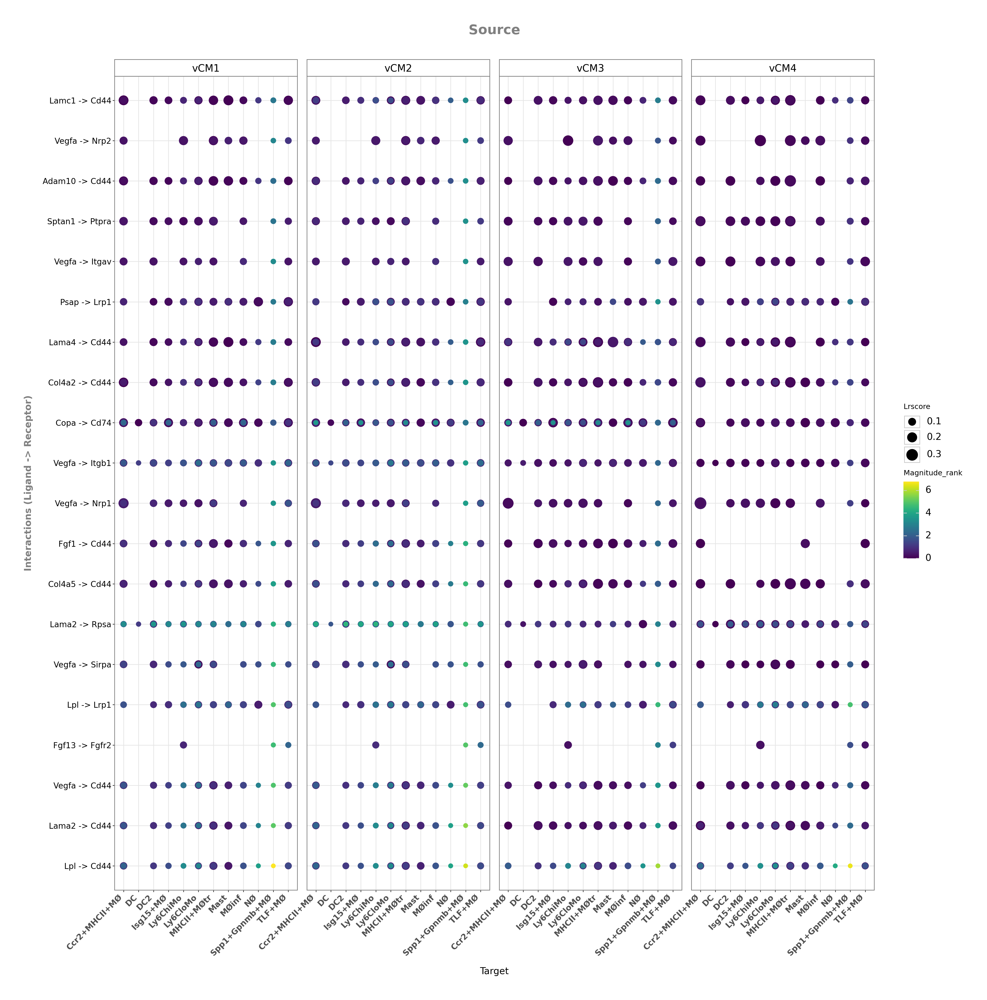

In [28]:
plot = li.pl.dotplot(
        cmc_mye,
        colour='magnitude_rank',
        size='lrscore',
        inverse_size=True,
        inverse_colour=True,
        source_labels=['vCM1', 'vCM2', 'vCM3', 'vCM4'],
        target_labels=['NØ', 'MHCII+MØtr', 'Ly6CloMo', 'Ly6ChiMo', 'Isg15+MØ','Spp1+Gpnmb+MØ','Ccr2+MHCII+MØ', 'DC', 'DC2', 'Isg15+MØ', 'MØinf', 'TLF+MØ' ,'Mast' ],
        top_n= 20,
        orderby='magnitude_rank',
        filter_fun=lambda x: x['spec_weight'] <= 0.01,
        orderby_ascending= True
    )
    
plot += theme(
        axis_text_y=element_text(size=12),  
        axis_title_y=element_text(size=14),  
        axis_title_x=element_text(size=14),  
        axis_text_x=element_text(size=12, angle=45, ha='right'), 
        plot_title=element_text(size=20),  
        figure_size=(20, 20)
    )
    
plot.save(f'./cmc_mye/cmc_mye_ccc.png', limitsize=False)
plot

The plot is based on lrscore and magnitude rank .The interaction with large dot size and dark(blue) colour indicates significance as high lrscore and low rank are preferred.

Note that interactiuons are filtered based on function given, i.e., having specificity weight < 0.01 as low rank indicates high specificity

#### Steps

1. Consider our liana results to a variable and obtain unique samples from it
2. Create a output directory if it not exists
3. Define desired source and target labels
4. Create a for loop for looping over individual sample data
5. A try, exception loop is created to handle errors in soruce and target labels missing
6. Filter the data for the current sample and the filter source and targets available
7. Use filtered source and targets for plotting if available, else skip sample by printing
8. Plot sample based on magnituderank, lrscore
9. Customize plot adn save

In [29]:
liana_res = cmc_mye.uns['liana_res']
unique_samples = liana_res['sample'].unique()

output_dir = './cmc_mye/sample_plots'
os.makedirs(output_dir, exist_ok=True)

csv_output_dir = './cmc_mye/liana_lr_pairs_per_sample'
os.makedirs(csv_output_dir, exist_ok=True)

source_labels = ['vCM1', 'vCM2', 'vCM3', 'vCM4']
target_labels = ['NØ', 'MHCII+MØtr', 'Ly6CloMo', 'Ly6ChiMo', 'Isg15+MØ','Spp1+Gpnmb+MØ','Ccr2+MHCII+MØ', 'DC', 'DC2', 'Isg15+MØ', 'MØinf', 'TLF+MØ' ,'Mast' ]

for sample in unique_samples:
    try:
        sample_data = liana_res[liana_res['sample'] == sample]

        available_sources = sample_data['source'].unique()
        available_targets = sample_data['target'].unique()
        
        filtered_sources = [label for label in source_labels if label in available_sources]
        filtered_targets = [label for label in target_labels if label in available_targets]

        if not filtered_sources or not filtered_targets:
            print(f"Skipping sample {sample} due to no available sources or targets.")
            continue

        plot = li.pl.dotplot(
            liana_res=sample_data,
            colour='magnitude_rank',
            size='lrscore',
            inverse_size=True,
            inverse_colour=True,
            source_labels=filtered_sources,
            target_labels=filtered_targets,
            top_n=20,
            orderby='magnitude_rank',
            filter_fun=lambda x: x['spec_weight'] <= 0.01,
            orderby_ascending=True
        )
        
        plot += theme(
            axis_text_y=element_text(size=12),
            axis_title_y=element_text(size=14),
            axis_title_x=element_text(size=14),
            axis_text_x=element_text(size=12, angle=45, ha='right'),
            figure_size=(30, 30)
        )
        
        plot_path = os.path.join(output_dir, f'{sample}_ccc.png')
        plot.save(plot_path, limitsize=False)

        sorted_data = sample_data.sort_values(by='magnitude_rank', ascending=False)

        csv_file_path = os.path.join(csv_output_dir, f'{sample}_ligand_receptor.csv')

        sorted_data.to_csv(csv_file_path, index=False)

    except Exception as e:
        print(f"Skipping sample {sample} due to error: {e}")

In [30]:
cmc_mye.write_h5ad('../data/cmc_mye_ccc_added.h5ad')

In [31]:
cmc_mye = sc.read_h5ad('../data/cmc_mye_ccc_added.h5ad')
cmc_mye

AnnData object with n_obs × n_vars = 25680 × 16060
    obs: 'seed_labels', 'donor', 'cell_states', 'sample', 'cell_source', 'genotype', 'cell_type', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'scrublet_score', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels'
    uns: 'liana_res'
    obsm: 'X_scANVI', 'X_scVI', 'X_umap'

# Tensor-Cell2cell


To find the variable CCC patterns across samples

## Building Tensor

#### Steps

1. Arranging samples in desired way
2. Adding them back to sample obs and arranging it properly
3. Sorting data based on sample

In [32]:
sorted_samples = ['A9_2', 'A10_2', 'A11_2','A12_2','B1_2', 'B2_2']
cmc_mye.obs['sample'] = pd.Categorical(cmc_mye.obs['sample'], categories=sorted_samples, ordered=True)
cmc_mye.obs = cmc_mye.obs.sort_values('sample')

In [33]:
cmc_mye.obs

,seed_labels,donor,cell_states,sample,cell_source,genotype,cell_type,n_counts,n_genes,percent_mito,...,pct_counts_mt,total_counts_ribo,pct_counts_ribo,percent_mt2,percent_chrY,XIST-counts,S_score,G2M_score,_scvi_batch,_scvi_labels
ACCCTTGAGAATCGTA-1-A9_2,Unknown,A9_2,NaN,A9_2,HIRI-Nuclei,WT,NØ,15424.233572,2683.0,NaN,...,7.667104,118.0,1.933159,0.076671,0.065531,0.0,-0.124612,-0.003555,0.0,34.0
GGTGTTAAGCTATCTG-1-A9_2,vCM3,A9_2,NaN,A9_2,HIRI-Nuclei,WT,vCM3,10250.303385,1654.0,NaN,...,6.778194,175.0,5.047592,0.067782,0.028843,0.0,0.028839,-0.192063,0.0,3.0
GTGTGATGTGGAAATT-1-A9_2,vCM2,A9_2,NaN,A9_2,HIRI-Nuclei,WT,vCM1,10206.236182,1619.0,NaN,...,0.774954,1.0,0.030998,0.007750,0.061996,0.0,-0.142927,-0.055287,0.0,2.0
ATGATCGTCGGACAAG-1-A9_2,vCM1,A9_2,NaN,A9_2,HIRI-Nuclei,WT,vCM4,10242.186236,1642.0,NaN,...,7.032641,122.0,3.620178,0.070326,0.029674,0.0,-0.001509,-0.277984,0.0,1.0
AACAACCTCAATCTCT-1-A9_2,vCM4,A9_2,NaN,A9_2,HIRI-Nuclei,WT,vCM4,8082.897279,1242.0,NaN,...,10.855365,91.0,2.830482,0.108554,0.062208,0.0,0.149306,-0.089954,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTCTTCCAGGACAAGA-1-B2_2,Unknown,B2_2,NaN,B2_2,HIRI-Nuclei,MdxSCID,DC2,12398.192595,2063.0,NaN,...,16.614616,24.0,0.499688,0.166146,0.104102,0.0,-0.072086,-0.209243,16.0,34.0
CGAGGCTAGTCGCTAT-1-B2_2,Unknown,B2_2,NaN,B2_2,HIRI-Nuclei,MdxSCID,MØinf,12667.239843,2133.0,NaN,...,2.199196,35.0,0.740114,0.021992,0.021146,0.0,0.180388,-0.257549,16.0,34.0
GGGCCATAGAGAGGGC-1-B2_2,Unknown,B2_2,NaN,B2_2,HIRI-Nuclei,MdxSCID,MØinf,13435.120934,2293.0,NaN,...,4.072398,67.0,1.378034,0.040724,0.102838,0.0,-0.339122,-0.383372,16.0,34.0
AATTCCTGTCGAGTGA-1-B2_2,Unknown,B2_2,NaN,B2_2,HIRI-Nuclei,MdxSCID,DC2,13712.678829,2326.0,NaN,...,3.395192,54.0,1.138760,0.033952,0.210881,0.0,0.064293,-0.478030,16.0,34.0


Clearly mention all the variables from uns as defaults may not give accurate results for analysis

how='outer' and outer_fraction=1/3 includes interactions present in at least one-third of the samples, 

In [34]:
tensor = li.multi.to_tensor_c2c(liana_res=cmc_mye.uns['liana_res'],
                                sample_key='sample', 
                                source_key='source', 
                                target_key='target',
                                ligand_key='ligand_complex', 
                                receptor_key='receptor_complex', 
                                score_key='magnitude_rank', 
                                inverse_fun=lambda x: 1 - x, 
                                how='outer', 
                                outer_fraction=1/3., 
                                context_order=sorted_samples, 
                                )
tensor

100%|██████████| 6/6 [00:06<00:00,  1.09s/it]


In [35]:
tensor.tensor.shape

torch.Size([6, 818, 14, 14])

In [36]:
c2c.io.export_variable_with_pickle(tensor, './cmc_mye/tensor_cmc_mye.pkl')

./cmc_mye/tensor_cmc_mye.pkl  was correctly saved.


## Building Metadata

##### Steps

1. Sort data by samples and set the index to samples and add column genotype
2. Create a dictionary mapping samples to genotypes
3. Add the metadata to tensor. here only first one is added and others are none as we dont have metadata for other dimensions (source cells, target cells, ligand-receptor pairs) 

In [37]:
context_dict = cmc_mye.obs.sort_values(by='sample') \
                        .set_index('sample')['genotype'] \
                        .to_dict()

In [38]:
dimensions_dict = [context_dict, None, None, None]
meta_tensor = c2c.tensor.generate_tensor_metadata(interaction_tensor=tensor,
                                                  metadata_dicts=dimensions_dict,
                                                  fill_with_order_elements=True
                                                 )

In [39]:
meta_tensor

[  Element Category
 0    A9_2       WT
 1   A10_2       WT
 2   A11_2      Mdx
 3   A12_2      Mdx
 4    B1_2  MdxSCID
 5    B2_2  MdxSCID,
              Element               Category
 0        Actr2^Adrb2  Ligand-Receptor Pairs
 1         Actr2^Ldlr  Ligand-Receptor Pairs
 2           Ada^Dpp4  Ligand-Receptor Pairs
 3         Adam10^Axl  Ligand-Receptor Pairs
 4       Adam10^Cadm1  Ligand-Receptor Pairs
 ..               ...                    ...
 813  Wnt2b^Fzd6_Lrp6  Ligand-Receptor Pairs
 814       Wnt5b^Fzd4  Ligand-Receptor Pairs
 815  Wnt5b^Fzd6_Lrp5  Ligand-Receptor Pairs
 816  Wnt5b^Fzd6_Lrp6  Ligand-Receptor Pairs
 817      Ybx1^Notch1  Ligand-Receptor Pairs
 
 [818 rows x 2 columns],
           Element       Category
 0   Ccr2+MHCII+MØ  Ccr2+MHCII+MØ
 1             DC2            DC2
 2        Isg15+MØ       Isg15+MØ
 3        Ly6ChiMo       Ly6ChiMo
 4        Ly6CloMo       Ly6CloMo
 5      MHCII+MØtr     MHCII+MØtr
 6            Mast           Mast
 7           MØinf  

In [40]:
c2c.io.export_variable_with_pickle(meta_tensor, './cmc_mye/tensor_metadata_cmc_mye.pkl')

./cmc_mye/tensor_metadata_cmc_mye.pkl  was correctly saved.


## Tensor-cell2cell Factorization

### Global analysis

Running Elbow Analysis


 64%|██████▍   | 16/25 [01:04<00:52,  5.88s/it]

100%|██████████| 25/25 [02:19<00:00,  5.59s/it]


The rank at the elbow is: 8
Running Tensor Factorization
Generating Outputs
Loadings of the tensor factorization were successfully saved into ./cmc_mye/Loadings.xlsx
CPU times: user 2min 26s, sys: 1.27 s, total: 2min 27s
Wall time: 2min 27s


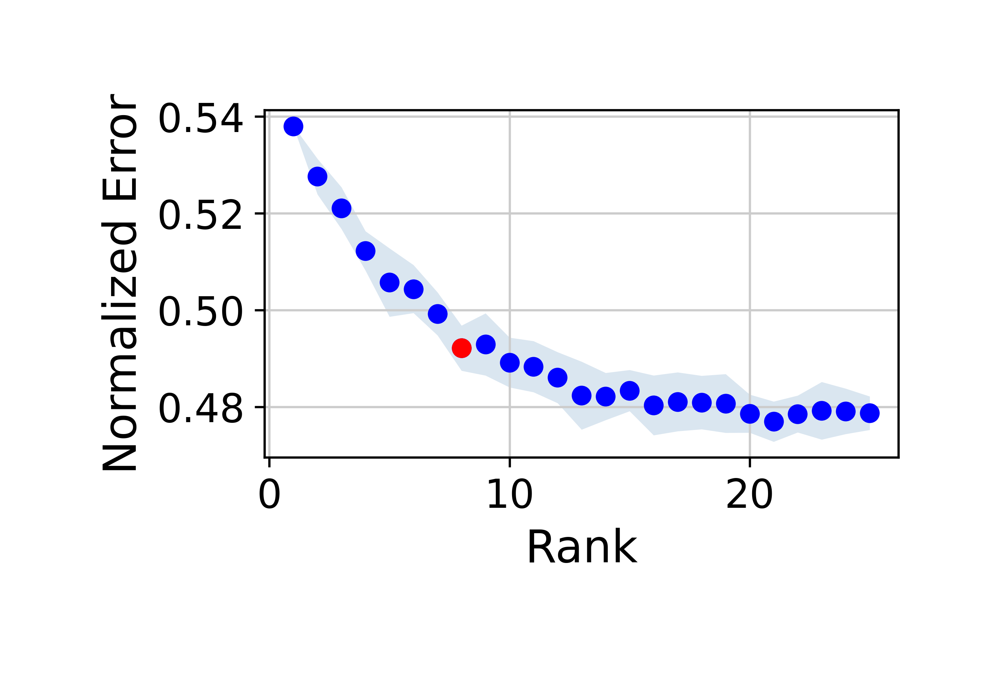

In [41]:
%%time
tensor2 = c2c.analysis.run_tensor_cell2cell_pipeline(tensor,
                                                    meta_tensor,
                                                    copy_tensor=True, 
                                                    rank= None,
                                                    tf_optimization='regular', 
                                                    random_state=0, 
                                                    device=device,
                                                    cmaps= ["gist_earth", "gray", "terrain", "terrain" ], 
                                                    output_fig=True,
                                                    output_folder= './cmc_mye',
                                                    backend='pytorch'
                                                    )

**tf_optimization**

- 'regular' : It uses 100 max iterations, 1 factorization run, and 10e-7 tolerance.Faster to run.
- 'robust' : It uses 500 max iterations, 100 factorization runs, and 10e-8 tolerance. Slower to run.

**elbow_metric**

- 'error' : Normalized error to compute the elbow.
- 'similarity' : Similarity based on CorrIndex (1-CorrIndex).


We dont know how many factors are optiaml and significant to represent the structure of our data, hence we use elbow method for detection. The elbow method identifies the optimal number of factors in a model by plotting Nomalized/reconstruction error against the number of factors and looks for a point where the error decrease slows significantly. This "elbow" point indicates a good balance between model complexity and fit, helping to avoid overfitting.

Heatmaps: Display the magnitude of interactions between sender and receiver cells, showing how strongly different ligand-receptor pairs interact across various contexts


In [42]:
meta_tensor2 = c2c.tensor.generate_tensor_metadata(interaction_tensor=tensor2,
                                                  metadata_dicts=dimensions_dict,
                                                  fill_with_order_elements=True
                                                 )

In [43]:
c2c.io.export_variable_with_pickle(tensor2, './cmc_mye/tensor_factorized_cmc_mye.pkl')
c2c.io.export_variable_with_pickle(meta_tensor2, './cmc_mye/tensor_factorized_metadata_cmc_mye.pkl')

./cmc_mye/tensor_factorized_cmc_mye.pkl  was correctly saved.
./cmc_mye/tensor_factorized_metadata_cmc_mye.pkl  was correctly saved.


### Factorization Results

In [44]:
tensor2 = c2c.io.load_variable_with_pickle('./cmc_mye/tensor_factorized_cmc_mye.pkl')
meta_tensor2 = c2c.io.load_variable_with_pickle( './cmc_mye/tensor_factorized_metadata_cmc_mye.pkl')

In [45]:
factors = tensor2.factors

In [46]:
factors.keys()

odict_keys(['Contexts', 'Ligand-Receptor Pairs', 'Sender Cells', 'Receiver Cells'])

In [47]:
factors['Contexts'].head()

,Factor 1,Factor 2,Factor 3,Factor 4,Factor 5,Factor 6,Factor 7,Factor 8
A9_2,0.299174,0.251893,0.349289,0.370341,0.371345,0.486212,0.418160,0.408116
A10_2,0.321655,0.329634,0.515687,0.579940,0.078342,0.078016,0.225231,0.499202
A11_2,0.502230,0.508514,0.435135,0.016419,0.349882,0.447321,0.442477,0.466483
A12_2,0.637103,0.448536,0.273397,0.140627,0.347232,0.577509,0.432878,0.128275
B1_2,0.383900,0.376395,0.392088,0.267285,0.576277,0.407736,0.432383,0.026105


####  Most variant Factor across Samples

In [48]:
sample_variation = np.var(factors['Contexts'].values, axis=0) # Calculate variance

most_variant_factor_index = np.argmax(sample_variation)
print("Variance of each factor:")
for index, variance in enumerate(sample_variation):
    print(f"Factor {index + 1}: {variance:.6f}")

print(f"\nMost variant factor index: {most_variant_factor_index + 1} (Factor {most_variant_factor_index + 1})")

Variance of each factor:
Factor 1: 0.034288
Factor 2: 0.007886
Factor 3: 0.005822
Factor 4: 0.051725
Factor 5: 0.025659
Factor 6: 0.027675
Factor 7: 0.006251
Factor 8: 0.041897

Most variant factor index: 4 (Factor 4)


Indicating that Factor 2 is varying alot across samples/Genotypes

In [49]:
sorted_lr_pairs = factors['Ligand-Receptor Pairs'].sort_values(by='Factor 4', ascending=False)
sorted_lr_pairs

,Factor 1,Factor 2,Factor 3,Factor 4,Factor 5,Factor 6,Factor 7,Factor 8
Hspa1a^Tlr4,0.004171,0.014537,0.014438,0.115808,0.047519,0.022651,0.063292,0.009037
S100a8^Cd69,0.088917,0.029688,0.008051,0.113091,0.075602,0.028911,0.036624,0.013986
Ado^Adora2b,0.004161,0.051899,0.001233,0.097678,0.078871,0.019106,0.074984,0.013234
Mfng^Notch1,0.060000,0.009923,0.061903,0.095204,0.049429,0.072243,0.087052,0.039103
Dcn^Tlr2,0.007480,0.081742,0.043779,0.093447,0.046189,0.033436,0.040944,0.102870
...,...,...,...,...,...,...,...,...
Pdgfa^Pdgfrb,0.053890,0.030067,0.032540,0.000256,0.007289,0.009611,0.023439,0.023484
Ptpn6^Clec12a,0.030158,0.009680,0.012683,0.000249,0.033889,0.028081,0.008047,0.020683
Cxcl1^Dpp4,0.058127,0.047209,0.061558,0.000115,0.068946,0.033380,0.012139,0.043691
Thy1^Itgax_Itgb2,0.042975,0.047272,0.034149,0.000112,0.014666,0.034813,0.048130,0.065553


### Most variant LR pair across samples based on factor contibution

In [50]:
factors['Ligand-Receptor Pairs'].iloc[:, 0:]

,Factor 1,Factor 2,Factor 3,Factor 4,Factor 5,Factor 6,Factor 7,Factor 8
Actr2^Adrb2,0.028033,0.018185,0.004972,0.056493,0.022624,0.012868,0.004590,0.032436
Actr2^Ldlr,0.014658,0.002524,0.002915,0.033691,0.014687,0.008126,0.013013,0.050300
Ada^Dpp4,0.009534,0.128465,0.034168,0.017714,0.071727,0.040098,0.105551,0.063367
Adam10^Axl,0.008510,0.024736,0.008704,0.019027,0.011015,0.015786,0.021309,0.030979
Adam10^Cadm1,0.060498,0.027974,0.025109,0.006810,0.024444,0.005366,0.013390,0.003109
...,...,...,...,...,...,...,...,...
Wnt2b^Fzd6_Lrp6,0.039103,0.026610,0.021591,0.017003,0.007841,0.019293,0.028757,0.036376
Wnt5b^Fzd4,0.041678,0.007853,0.057649,0.020499,0.023203,0.020427,0.034126,0.011070
Wnt5b^Fzd6_Lrp5,0.021563,0.024664,0.017157,0.005339,0.005301,0.013770,0.033219,0.042059
Wnt5b^Fzd6_Lrp6,0.020616,0.022379,0.004384,0.013621,0.012990,0.010686,0.006049,0.015791


In [51]:
lr_variation = factors['Ligand-Receptor Pairs'].iloc[:, 0:].var(axis=1).sort_values(ascending=False)
lr_variation

Ptdss1^Jmjd6           0.002320
Tnfsf13b^Tnfrsf13b     0.001850
Psen1^Ncstn            0.001813
Gstp1^Traf2            0.001758
Ada^Dpp4               0.001757
                         ...   
Wnt5b^Fzd6_Lrp6        0.000040
Fndc5^Itgav            0.000035
Angptl2^Itga5_Itgb1    0.000029
Cxcl12^Itgav           0.000029
Lamb1^Itga6_Itgb1      0.000028
Length: 818, dtype: float32

variance - Square root of deviation from mean
First mean is calculated and then deviation from mean is calculated and square of each deviation and its root is variance.

The variance provides insight into how much the contributions of ligand-receptor pairs vary across genotypes. 

A higher variance indicates greater variability, while a lower variance suggests that contributions are more consistent across ssamples based on factor contibution

## Downstream Analyses of Factor Loadings

### Visualization of factor contributions

#### Steps

1. Specify the samples to subset and subest the factors dataframe
2. Create an output folder for plots
3. Setup heatmap plotting
4. Create a for loop to generate plot per factor
5. Add customizations and save them

In [52]:
factors_df = factors['Contexts']

<Figure size 3000x1800 with 0 Axes>

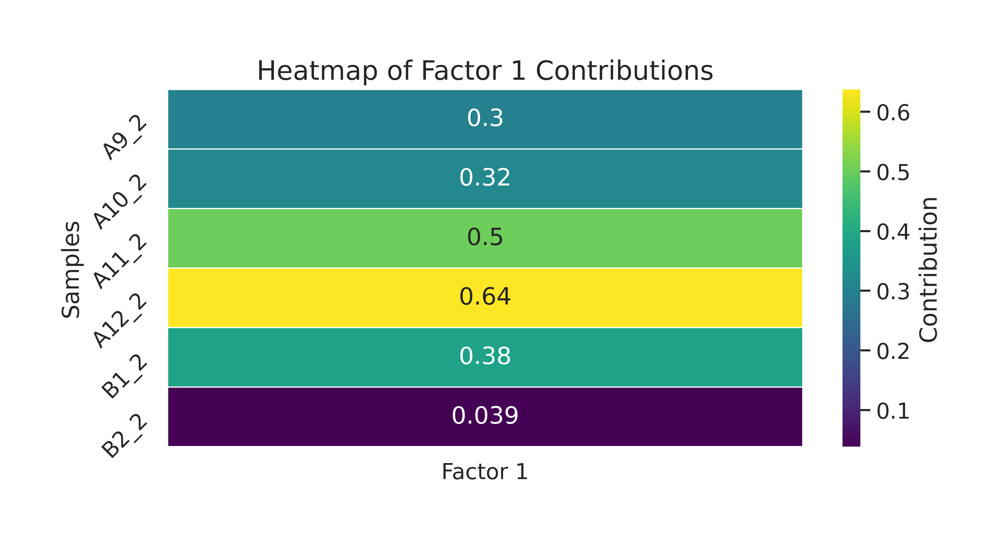

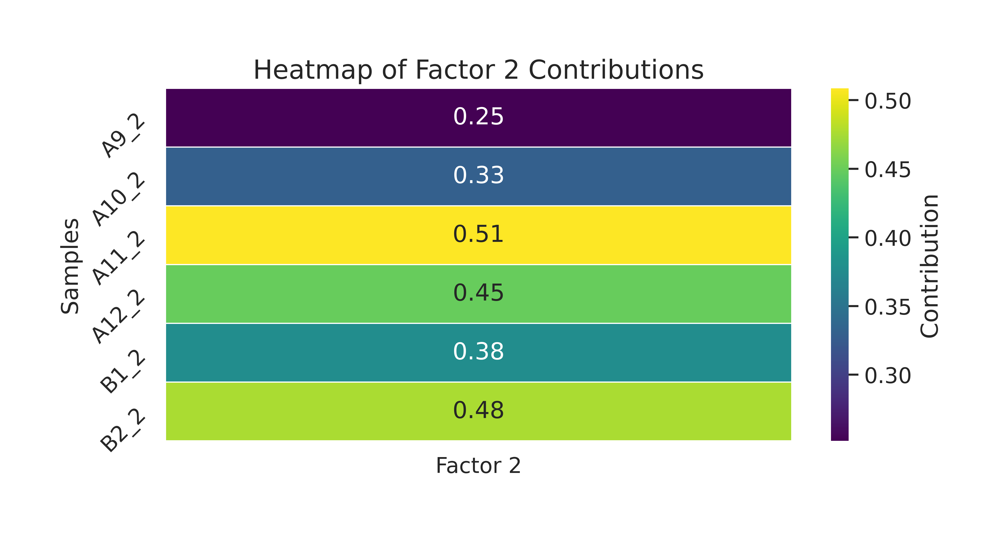

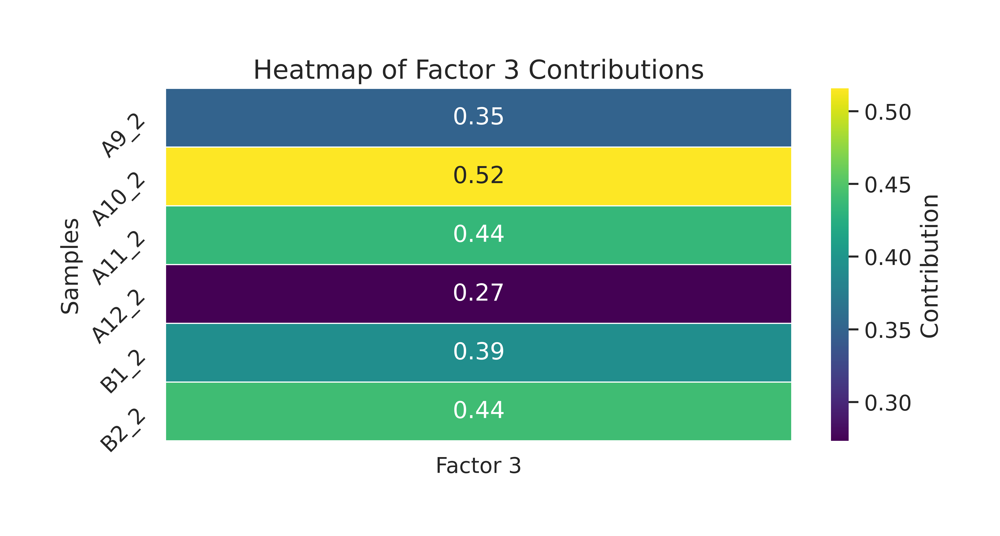

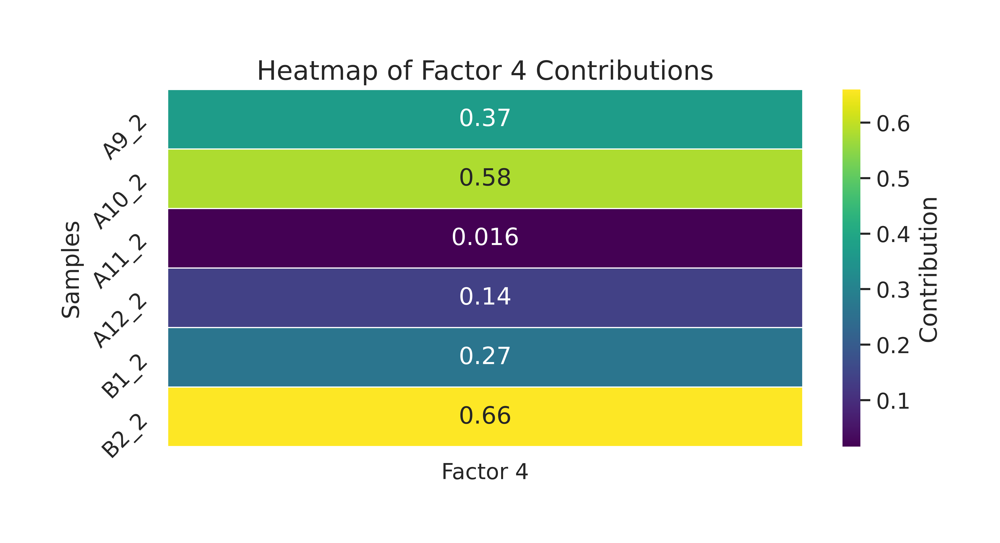

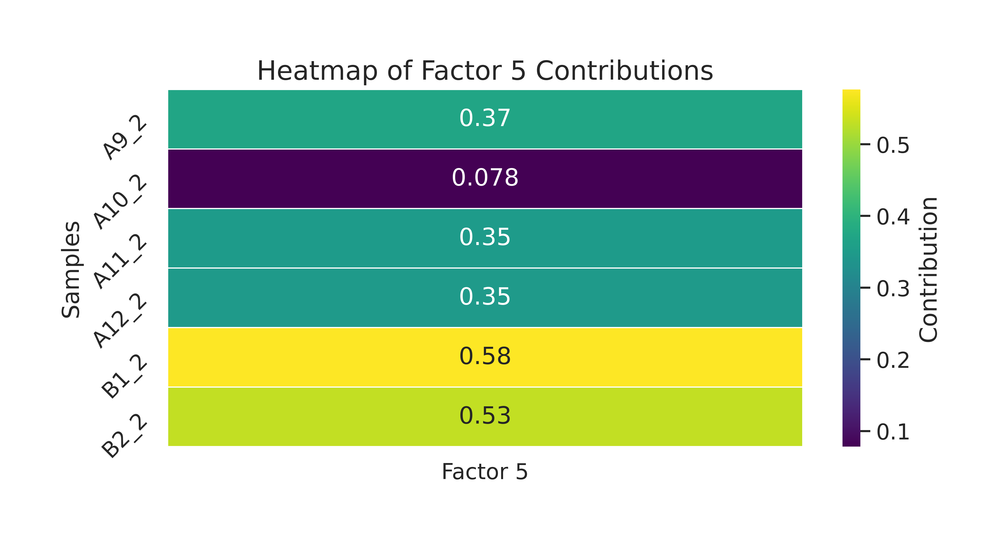

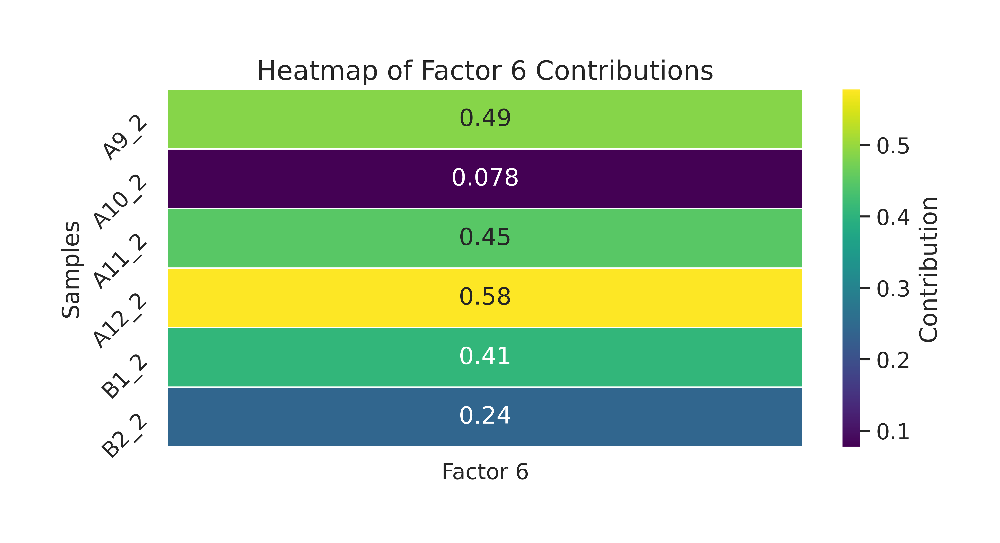

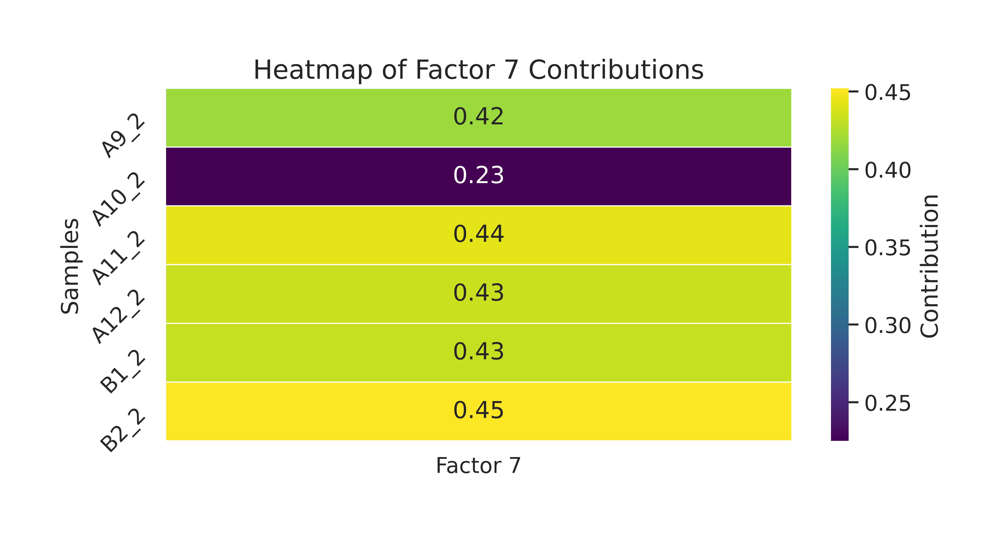

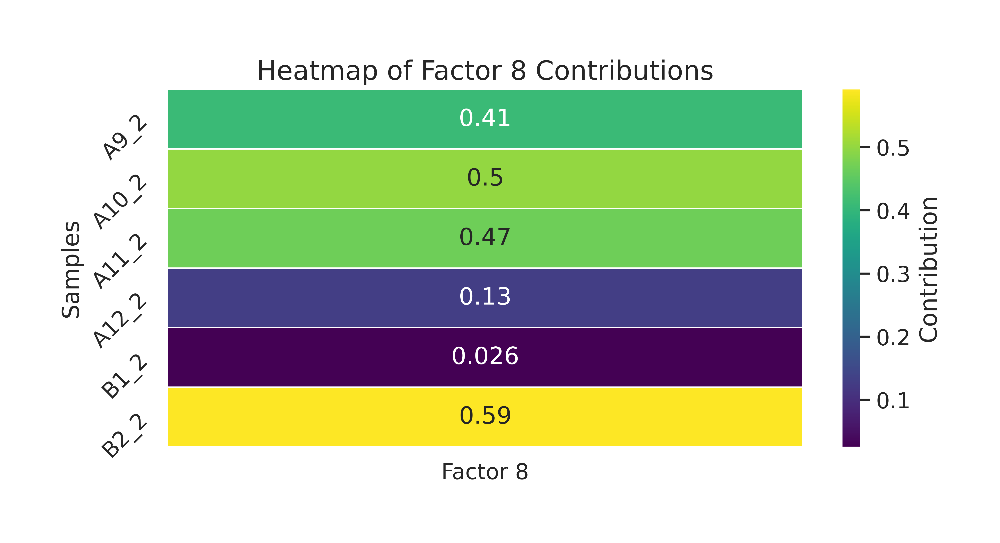

In [53]:
selected_samples = ['A9_2', 'A10_2', 'A11_2', 'A12_2', 'B1_2', 'B2_2']  
subset_factors = factors_df.loc[selected_samples]

output_dir = './cmc_mye/heatmap_plots'
os.makedirs(output_dir, exist_ok=True)

plt.figure(figsize=(10, 6))
sns.set(font_scale=1.2)

for factor in subset_factors.columns:
    plt.figure(figsize=(8, 4))
    sns.heatmap(subset_factors[[factor]], annot=True, cmap='viridis', cbar_kws={'label': 'Contribution'}, linewidths=.5)
    plt.title(f'Heatmap of {factor} Contributions', fontsize=16)
    plt.ylabel('Samples' ,fontsize=14)
    plt.yticks(rotation=45)
    plt.tight_layout()
    plt.savefig(os.path.join(output_dir, f'{factor}_heatmap.png'), dpi=300)
    plt.show()

<Figure size 3000x1800 with 0 Axes>

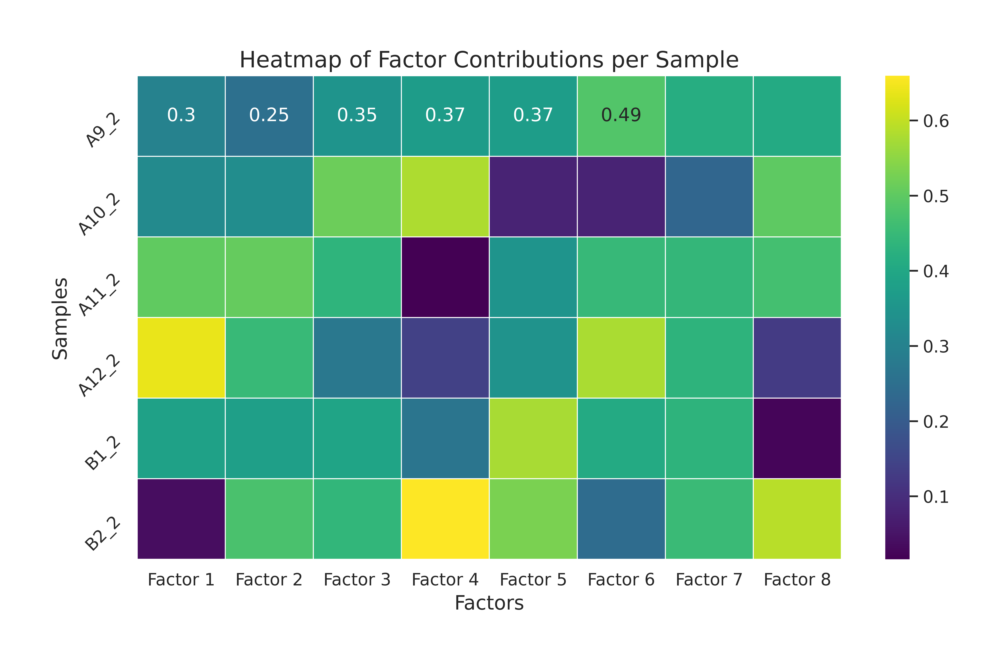

In [54]:
plt.figure(figsize=(10, 6))
sns.set(font_scale=1.1)


plt.figure(figsize=(10, 6))
sns.heatmap(subset_factors, annot=True, cmap='viridis', linewidths=.5)
plt.title('Heatmap of Factor Contributions per Sample', fontsize=16)
plt.ylabel('Samples', fontsize=14)
plt.xlabel('Factors', fontsize=14)
plt.yticks(rotation=45)
plt.tight_layout()
plt.savefig(os.path.join(output_dir, 'all_factors_heatmap.png'), dpi=300)
plt.show()

### Stastical testing

In [55]:
context_dict
context_dict = cmc_mye.obs.sort_values(by='sample') \
                        .set_index('sample')['genotype'] \
                        .to_dict()

context_dict

{'A9_2': 'WT',
 'A10_2': 'WT',
 'A11_2': 'Mdx',
 'A12_2': 'Mdx',
 'B1_2': 'MdxSCID',
 'B2_2': 'MdxSCID'}

In [56]:
factors

OrderedDict([('Contexts',
                     Factor 1  Factor 2  Factor 3  Factor 4  Factor 5  Factor 6  Factor 7  \
              A9_2   0.299174  0.251893  0.349289  0.370341  0.371345  0.486212  0.418160   
              A10_2  0.321655  0.329634  0.515687  0.579940  0.078342  0.078016  0.225231   
              A11_2  0.502230  0.508514  0.435135  0.016419  0.349882  0.447321  0.442477   
              A12_2  0.637103  0.448536  0.273397  0.140627  0.347232  0.577509  0.432878   
              B1_2   0.383900  0.376395  0.392088  0.267285  0.576277  0.407736  0.432383   
              B2_2   0.038973  0.475864  0.440729  0.659568  0.529983  0.240104  0.451983   
              
                     Factor 8  
              A9_2   0.408116  
              A10_2  0.499202  
              A11_2  0.466483  
              A12_2  0.128275  
              B1_2   0.026105  
              B2_2   0.591182  ),
             ('Ligand-Receptor Pairs',
                               Factor 1  Fa

In [57]:
factors['Contexts'].describe()

,Factor 1,Factor 2,Factor 3,Factor 4,Factor 5,Factor 6,Factor 7,Factor 8
count,6.000000,6.000000,6.000000,6.000000,6.000000,6.000000,6.000000,6.000000
mean,0.363839,0.398473,0.401054,0.339030,0.375510,0.372816,0.400519,0.353227
std,0.202843,0.097280,0.083586,0.249139,0.175472,0.182235,0.086612,0.224225
min,0.038973,0.251893,0.273397,0.016419,0.078342,0.078016,0.225231,0.026105
25%,0.304794,0.341324,0.359989,0.172291,0.347895,0.282012,0.421716,0.198235
50%,0.352778,0.412466,0.413612,0.318813,0.360613,0.427529,0.432630,0.437300
75%,0.472648,0.469032,0.439331,0.527541,0.490324,0.476489,0.440077,0.491022
max,0.637103,0.508514,0.515687,0.659568,0.576277,0.577509,0.451983,0.591182


#### Data distribution

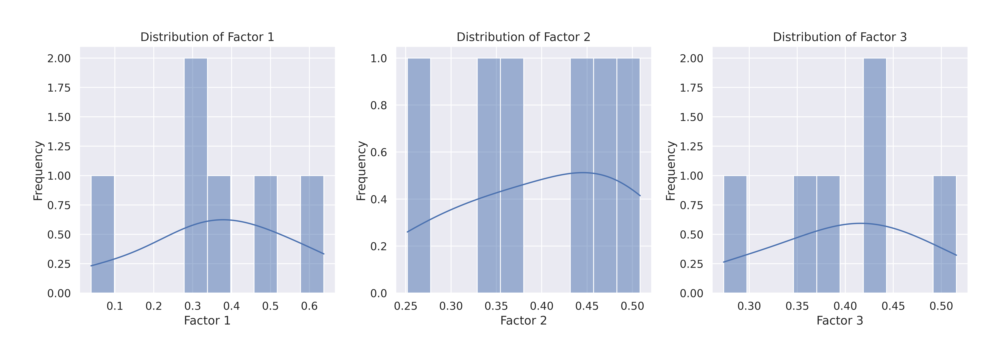

In [58]:
factors_visualization = ['Factor 1', 'Factor 2', 'Factor 3']

plt.figure(figsize=(15, 5))
for i, factor in enumerate(factors_visualization):
    plt.subplot(1, 3, i + 1)
    sns.histplot(factors_df[factor], bins=10, kde=True)  
    plt.title(f'Distribution of {factor}')
    plt.xlabel(factor)
    plt.ylabel('Frequency')

plt.tight_layout()
plt.show()

In [59]:
for factor in factors_df.columns:
    stat, p = shapiro(factors_df[factor])
    print(f'{factor}: Statistics={stat}, p-value={p}')
    if p > 0.05:
        print(f'{factor} looks Gaussian (fail to reject H0)')
    else:
        print(f'{factor} does not look Gaussian (reject H0)')


Factor 1: Statistics=0.9715569044500016, p-value=0.9027251128385334
Factor 1 looks Gaussian (fail to reject H0)
Factor 2: Statistics=0.9535784657631758, p-value=0.7691347540905149
Factor 2 looks Gaussian (fail to reject H0)
Factor 3: Statistics=0.982421878103793, p-value=0.9629436124805693
Factor 3 looks Gaussian (fail to reject H0)
Factor 4: Statistics=0.9603705839974741, p-value=0.8225921813734405
Factor 4 looks Gaussian (fail to reject H0)
Factor 5: Statistics=0.9054266711263732, p-value=0.40699889525357946
Factor 5 looks Gaussian (fail to reject H0)
Factor 6: Statistics=0.9336476969698292, p-value=0.6085509832180129
Factor 6 looks Gaussian (fail to reject H0)
Factor 7: Statistics=0.6213691176057621, p-value=0.0008239499411114529
Factor 7 does not look Gaussian (reject H0)
Factor 8: Statistics=0.8884981785872363, p-value=0.3103934920096845
Factor 8 looks Gaussian (fail to reject H0)


If the p-value from the Shapiro-Wilk test is greater than 0.05, you fail to reject the null hypothesis, meaning the data is likely normally distributed.

For normally distributed data, t-test is used and for data which is not normally distributed, the Mann-Whitney-Wilcoxon test is used

#### Boxplots to statistically compare group of samples

In [60]:
c2c.plotting.context_boxplot(context_loadings=factors['Contexts'],
                                         metadict=context_dict,
                                         nrows=4,
                                         figsize=(10, 25),
                                         statistical_test='t-test_ind',
                                         pval_correction='fdr_bh',
                                         cmap='Greys',
                                         verbose=True,
                                         title_size=12,
                                         axis_label_size=12,
                                         filename = './cmc_mye/stat_tests_lym.png')

plt.show()

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Mdx vs. MdxSCID: t-test independent samples with Benjamini-Hochberg correction, P_val:1.927e-01 t=1.935e+00
MdxSCID vs. WT: t-test independent samples with Benjamini-Hochberg correction, P_val:6.247e-01 t=-5.727e-01
Mdx vs. WT: t-test independent samples with Benjamini-Hochberg correction, P_val:6.304e-02 t=3.792e+00
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Mdx vs. MdxSCID: t-test independent samples with Benjamini-Hochberg correction, P_val:4.622e-01 t=9.022e-01
MdxSCID vs. WT: t-test independent samples with Benjamini-Hochberg correction, P_val:1.652e-01 t=2.144e+00
Mdx vs. WT: t-test independent samples with Benjamini-Hochberg correction, P_val:6.207e-02 t=3.825e+00
p

It is observed that via t-test we got to know that Factor 3 has significant differences in between genotypes. 

In [61]:
c2c.plotting.context_boxplot(context_loadings=factors['Contexts'],
                                         metadict=context_dict,
                                         nrows=4,
                                         figsize=(10, 25),
                                         statistical_test='Mann-Whitney',
                                         pval_correction='benjamini-hochberg',
                                         cmap='Greys',
                                         verbose=True,
                                         title_size=12,
                                         axis_label_size=12)

plt.show()

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Mdx vs. MdxSCID: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:3.333e-01 U_stat=4.000e+00
MdxSCID vs. WT: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:1.000e+00 U_stat=2.000e+00
Mdx vs. WT: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:3.333e-01 U_stat=4.000e+00
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Mdx vs. MdxSCID: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:6.667e-01 U_stat=3.000e+00
MdxSCID vs. WT: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:3.333e-01 U_stat=4.000e+00
Mdx vs. WT: Mann-Whitney-Wilco

Mann-Whitneey is very strict and it gave out no significant results which means that the groups doesnt have any significant differences in patterns shown by them based on genotype.

### Finding Correlation between genotypes

We first define the ranking of the severity, where higher values represent the worst severity.

In [62]:
def severity_rank(x):
    if x == 'WT':
        ranking = 1
    elif x == 'MdxSCID':
        ranking = 2
    elif x == 'Mdx':
        ranking = 3
    return ranking

We generate a dataframe with the same indexes as the dataframe containing the loadings, then assign those rankings here

In [63]:
sev_rank = pd.DataFrame(index=factors['Contexts'].index)
sev_rank['Severity-Ranking'] = [severity_rank(context_dict[idx]) for idx in factors['Contexts'].index]
sev_rank.head

<bound method NDFrame.head of        Severity-Ranking
A9_2                  1
A10_2                 1
A11_2                 3
A12_2                 3
B1_2                  2
B2_2                  2>

Number of factors from the tensor decomposition

In [64]:
nfactors = factors['Contexts'].shape[1]

Spearman correlation

In [65]:
for i in range(1, nfactors+1):
    factor = 'Factor {}'.format(i)
    print(factor, scipy.stats.spearmanr(factors['Contexts'][factor],
                                sev_rank['Severity-Ranking']))


Factor 1 SignificanceResult(statistic=0.7171371656006363, pvalue=0.1087009513249235)
Factor 2 SignificanceResult(statistic=0.8366600265340757, pvalue=0.03784096948581305)
Factor 3 SignificanceResult(statistic=-0.35856858280031817, pvalue=0.4851979632652574)
Factor 4 SignificanceResult(statistic=-0.7171371656006363, pvalue=0.1087009513249235)
Factor 5 SignificanceResult(statistic=0.0, pvalue=1.0)
Factor 6 SignificanceResult(statistic=0.4780914437337575, pvalue=0.33750185654036463)
Factor 7 SignificanceResult(statistic=0.7171371656006363, pvalue=0.1087009513249235)
Factor 8 SignificanceResult(statistic=-0.23904572186687875, pvalue=0.648261294967307)


Only Factor 2 demonstrates statistical significance (p < 0.05), indicating an significant effect between samples

### Heatmaps

#### Cluster samples by their importance across factors

##### Steps

1. Genwerate color accordingg to severity of sample
2. Map the colors to sample names
3. Create a datafram,e woith the color info

In [66]:
condition_colors = c2c.plotting.aesthetics.get_colors_from_labels(['WT', 'MdxSCID','Mdx' ],
                                                                  cmap='RdYlBu')


color_dict = {k : condition_colors[v] for k, v in context_dict.items()}


col_colors = pd.Series(color_dict)
col_colors = col_colors.to_frame()
col_colors.columns = ['Genotype colors']
col_colors.head()

,Genotype colors
A9_2,"(0.6470588235294118, 0.0, 0.14901960784313725,..."
A10_2,"(0.6470588235294118, 0.0, 0.14901960784313725,..."
A11_2,"(0.7398692810457519, 0.884967320261438, 0.9333..."
A12_2,"(0.7398692810457519, 0.884967320261438, 0.9333..."
B1_2,"(0.9934640522875817, 0.7477124183006535, 0.441..."


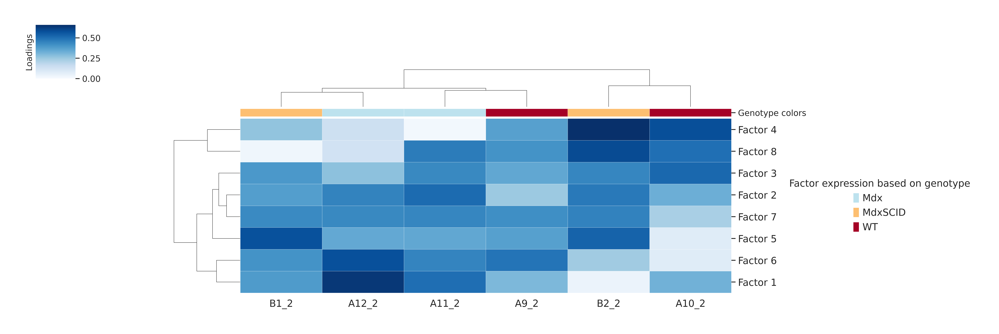

In [67]:
sample_cm = c2c.plotting.loading_clustermap(factors['Contexts'],
                                            use_zscore=False, 
                                            col_colors=col_colors, 
                                            figsize=(16, 6),
                                            dendrogram_ratio=0.3,
                                            cbar_fontsize=12,
                                            tick_fontsize=14,
                                            filename='./cmc_mye/Clustermap-Contexts.pdf'
                                           )

plt.sca(sample_cm.ax_heatmap)
legend = c2c.plotting.aesthetics.generate_legend(color_dict=condition_colors,
                                                 bbox_to_anchor=(1.1, 0.5), 
                                                 title='Factor expression based on genotype'
                                                )

Here samples are grouped by the importance that each factor has in relation to the other samples. This captures combinations of related factors that explain similarities and differences at a sample-specific resolution

#### Cluster LR pairs by their importance across factors

In [68]:
lr_cm = c2c.plotting.loading_clustermap(factors['Ligand-Receptor Pairs'],
                                        loading_threshold=0.1, #LR contribution is atleast  10%
                                        use_zscore=False, 
                                        figsize=(28, 8),
                                        filename='./cmc_mye/Clustermap-LRs.pdf',
                                        row_cluster=False 
                                       )

LR pairs are grouped according to how important they for one factor versus the others. This can give an idea of the molecular mechanisms that are crucial in each communication pattern.

### Factor specific analysis

#### Cluster sender-receiver pairs for an specific factor

To determine the cellular interactions underlying specific factor(Factor 2) . 

We define its Loading Product between senders and receiver cells  which represents the joint importance of the cell-cell pair

In [69]:
selected_factor = 'Factor 2'

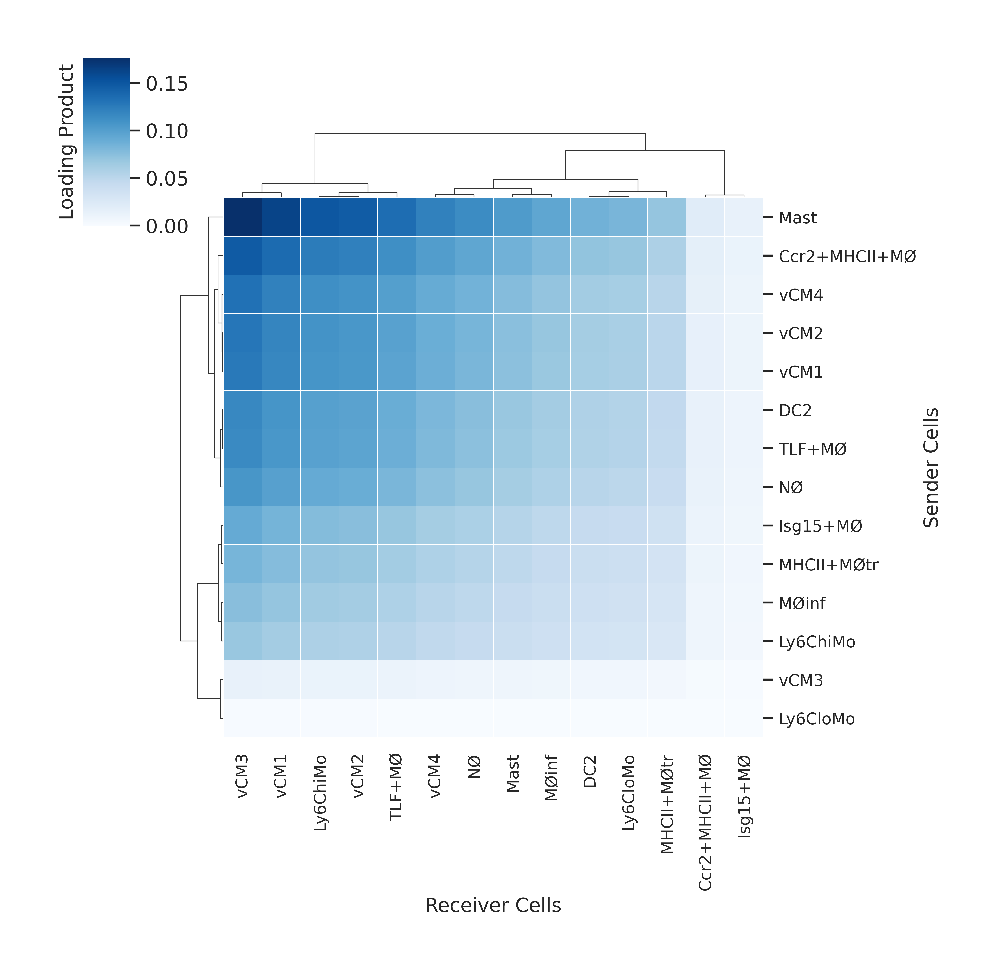

In [70]:
loading_product = c2c.analysis.tensor_downstream.get_joint_loadings(factors,
                                                                    dim1='Sender Cells',
                                                                    dim2='Receiver Cells',
                                                                    factor=selected_factor,
                                                                   )
lprod_cm = c2c.plotting.loading_clustermap(loading_product.T, 
                                           use_zscore=False, 
                                           figsize=(8, 8),
                                           filename='./cmc_mye/Clustermap-CC-Pairs-Factor2.pdf',
                                           cbar_label='Loading Product',
                                          )

#### Cluster Ligand-Receptor pairs and sample for an specific factor

In [71]:
joint_loadings = c2c.analysis.tensor_downstream.get_joint_loadings(
    factors,
    dim1='Ligand-Receptor Pairs',
    dim2='Contexts',
    factor=selected_factor
)

joint_loadings

Contexts,A9_2,A10_2,A11_2,A12_2,B1_2,B2_2
Ligand-Receptor Pairs,,,,,,
Actr2^Adrb2,0.004581,0.005995,0.009248,0.008157,0.006845,0.008654
Actr2^Ldlr,0.000636,0.000832,0.001283,0.001132,0.000950,0.001201
Ada^Dpp4,0.032360,0.042347,0.065326,0.057621,0.048354,0.061132
Adam10^Axl,0.006231,0.008154,0.012579,0.011095,0.009310,0.011771
Adam10^Cadm1,0.007046,0.009221,0.014225,0.012547,0.010529,0.013312
...,...,...,...,...,...,...
Wnt2b^Fzd6_Lrp6,0.006703,0.008771,0.013531,0.011935,0.010016,0.012663
Wnt5b^Fzd4,0.001978,0.002589,0.003994,0.003523,0.002956,0.003737
Wnt5b^Fzd6_Lrp5,0.006213,0.008130,0.012542,0.011062,0.009283,0.011736


In [72]:
variance = joint_loadings.var(axis=1)

variability_df = pd.DataFrame({
    'Ligand-Receptor Pair': variance.index,
    'Variance': variance.values
})
variability_df.to_csv('./cmc_mye/lr_pairs-variance-Factor2.csv', index=False)

most_varying_lr_pairs = variability_df.sort_values(by='Variance', ascending=False)

top_n = 20  
top_varying_lr_pairs = most_varying_lr_pairs.head(top_n)

print(top_varying_lr_pairs)

    Ligand-Receptor Pair  Variance
776   Tnfsf13b^Tnfrsf13b  0.000169
2               Ada^Dpp4  0.000156
250            Dcn^Erbb4  0.000142
774        Tnfsf13b^Cd40  0.000127
346          Gnai2^Adcy8  0.000109
302          Fgf13^Scn5a  0.000099
311           Fgf1^Fgfr2  0.000099
313          Fgf1^Tgfbr3  0.000094
301          Fgf13^Fgfr2  0.000088
515            Lpl^Vldlr  0.000085
64            Apoe^Vldlr  0.000078
62            Apoe^Sorl1  0.000076
399           Hspa8^Ldlr  0.000076
371           Gstp1^Egfr  0.000064
252             Dcn^Tlr2  0.000063
101            Bmp2^Rgmb  0.000062
631          S100a1^Ryr2  0.000061
58             Apoe^Lrp6  0.000061
184          Col1a2^Cd36  0.000060
253             Dcn^Tlr4  0.000059


In [73]:
filtered_joint_loadings = joint_loadings.loc[top_varying_lr_pairs['Ligand-Receptor Pair']]

c2c.plotting.loading_clustermap(
    filtered_joint_loadings,
    use_zscore=False,
    figsize=(30, 10),
    filename='./cmc_mye/Clustermap-Top-Varying-LRs-Factor2.pdf',
    cbar_label='Loading Product'
)

1. **Tnfsf13b^Tnfrsf13b**: Tumor necrosis factor ligand superfamily member 13b (Tnfsf13b) interacts with tumor necrosis factor receptor superfamily member 13b (Tnfrsf13b), playing a role in immune response modulation and possibly influencing B cell development.

2. **Ada^Dpp4**: Adenosine deaminase (Ada) binds to dipeptidyl peptidase 4 (Dpp4), involved in immune regulation and metabolism, particularly in T cell activation and insulin regulation.

3. **Dcn^Erbb4**: Decorin (Dcn) interacts with ErbB4, potentially regulating signaling pathways involved in development, cell proliferation, and tissue repair.

4. **Tnfsf13b^Cd40**: Tnfsf13b also binds to CD40, which is crucial for B cell activation, influencing immune responses and inflammatory processes.

5. **Gnai2^Adcy8**: G protein subunit alpha I2 (Gnai2) interacts with adenylate cyclase 8 (Adcy8), involved in modulating intracellular signaling pathways, particularly in the context of cardiac function.

6. **Fgf13^Scn5a**: Fibroblast growth factor 13 (Fgf13) binds to sodium channel protein SCN5A (Scn5a), playing a key role in cardiac conduction and excitability.

7. **Fgf1^Fgfr2**: Fibroblast growth factor 1 (Fgf1) interacts with fibroblast growth factor receptor 2 (Fgfr2), promoting cellular proliferation and differentiation, particularly in neuronal development.

8. **Fgf1^Tgfbr3**: Fgf1 also binds to transforming growth factor beta receptor 3 (Tgfbr3), involved in various cellular processes including proliferation and apoptosis.

9. **Fgf13^Fgfr2**: Another interaction of Fgf13 with Fgfr2, highlighting its importance in growth factor signaling and cellular responses.

10. **Lpl^Vldlr**: Lipoprotein lipase (Lpl) interacts with very low-density lipoprotein receptor (Vldlr), influencing lipid metabolism and cellular uptake of lipoproteins.

11. **Apoe^Vldlr**: Apolipoprotein E (Apoe) also binds to Vldlr, playing a role in lipid metabolism, cholesterol transport, and neuronal repair processes.

12. **Apoe^Sorl1**: Apoe interacts with sortilin-related receptor 1 (Sorl1), potentially involved in amyloid precursor protein processing and Alzheimer’s disease pathology.

13. **Hspa8^Ldlr**: Heat shock protein family A (Hsp70) member 8 (Hspa8) binds to low-density lipoprotein receptor (Ldlr), impacting cholesterol uptake and cellular stress responses.

14. **Gstp1^Egfr**: Glutathione S-transferase P1 (Gstp1) interacts with epidermal growth factor receptor (Egfr), potentially involved in modulating cell survival and proliferation.

15. **Dcn^Tlr2**: Decorin also binds to Toll-like receptor 2 (Tlr2), playing a role in the immune response and inflammation.

16. **Bmp2^Rgmb**: Bone morphogenetic protein 2 (Bmp2) interacts with RGM domain family member B (Rgmb), influencing bone development and regeneration.

17. **S100a1^Ryr2**: S100 calcium-binding protein A1 (S100a1) interacts with ryanodine receptor 2 (Ryr2), crucial for calcium signaling in cardiac muscle.

18. **Apoe^Lrp6**: Another interaction of Apoe with low-density lipoprotein receptor-related protein 6 (Lrp6), which may influence Wnt signaling pathways.

19. **Col1a2^Cd36**: Collagen type I alpha 2 (Col1a2) binds to cluster of differentiation 36 (Cd36), impacting tissue remodeling and inflammatory responses.

20. **Dcn^Tlr4**: Decorin also interacts with Toll-like receptor 4 (Tlr4), potentially modulating immune responses and inflammation.


##### 1. Immune Regulation
- Tnfsf13b^Tnfrsf13b
- Tnfsf13b^Cd40
- Ada^Dpp4
- Dcn^Tlr2
- Dcn^Tlr4

##### 2. Growth and Development
- Dcn^Erbb4
- Fgf1^Fgfr2
- Fgf1^Tgfbr3
- Fgf13^Fgfr2
- Bmp2^Rgmb

##### 3. Lipid Metabolism
- Lpl^Vldlr
- Apoe^Vldlr
- Apoe^Sorl1
- Hspa8^Ldlr
- Apoe^Lrp6

##### 4. Cardiac Function
- Gnai2^Adcy8
- Fgf13^Scn5a
- S100a1^Ryr2

##### 5. Cell Signaling
- Gstp1^Egfr
- Dcn^Tlr2
- Dcn^Tlr4
- Fgf1^Tgfbr3

#### Evaluation of sender-receiver pair and LR pairs used in a specific factor

In [74]:
sns.set(font_scale=0.5)

lr_cell_product = c2c.analysis.tensor_downstream.get_lr_by_cell_pairs(
    factors,
    lr_label='Ligand-Receptor Pairs',
    sender_label='Sender Cells',
    receiver_label='Receiver Cells',
    order_cells_by='receivers',
    factor=selected_factor,
    cci_threshold=None, 
    lr_threshold=0.075 
)

lsr_prod_cm = c2c.plotting.loading_clustermap(
    lr_cell_product,
    use_zscore=False, 
    figsize=(12, 28),
    cbar_label='Loading Product',
    filename= './cmc_mye/Clustermap-LR-CC-Pairs-Factor2.pdf',
    yticklabels=1  
)

plt.setp(lsr_prod_cm.ax_heatmap.yaxis.get_majorticklabels(), fontsize=6)

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,

In [75]:
factors['Ligand-Receptor Pairs']

,Factor 1,Factor 2,Factor 3,Factor 4,Factor 5,Factor 6,Factor 7,Factor 8
Ligand-Receptor Pairs,,,,,,,,
Actr2^Adrb2,0.028033,0.018185,0.004972,0.056493,0.022624,0.012868,0.004590,0.032436
Actr2^Ldlr,0.014658,0.002524,0.002915,0.033691,0.014687,0.008126,0.013013,0.050300
Ada^Dpp4,0.009534,0.128465,0.034168,0.017714,0.071727,0.040098,0.105551,0.063367
Adam10^Axl,0.008510,0.024736,0.008704,0.019027,0.011015,0.015786,0.021309,0.030979
Adam10^Cadm1,0.060498,0.027974,0.025109,0.006810,0.024444,0.005366,0.013390,0.003109
...,...,...,...,...,...,...,...,...
Wnt2b^Fzd6_Lrp6,0.039103,0.026610,0.021591,0.017003,0.007841,0.019293,0.028757,0.036376
Wnt5b^Fzd4,0.041678,0.007853,0.057649,0.020499,0.023203,0.020427,0.034126,0.011070
Wnt5b^Fzd6_Lrp5,0.021563,0.024664,0.017157,0.005339,0.005301,0.013770,0.033219,0.042059


In [76]:
lr_pairs_df = factors['Ligand-Receptor Pairs']
lr_pairs_df

,Factor 1,Factor 2,Factor 3,Factor 4,Factor 5,Factor 6,Factor 7,Factor 8
Ligand-Receptor Pairs,,,,,,,,
Actr2^Adrb2,0.028033,0.018185,0.004972,0.056493,0.022624,0.012868,0.004590,0.032436
Actr2^Ldlr,0.014658,0.002524,0.002915,0.033691,0.014687,0.008126,0.013013,0.050300
Ada^Dpp4,0.009534,0.128465,0.034168,0.017714,0.071727,0.040098,0.105551,0.063367
Adam10^Axl,0.008510,0.024736,0.008704,0.019027,0.011015,0.015786,0.021309,0.030979
Adam10^Cadm1,0.060498,0.027974,0.025109,0.006810,0.024444,0.005366,0.013390,0.003109
...,...,...,...,...,...,...,...,...
Wnt2b^Fzd6_Lrp6,0.039103,0.026610,0.021591,0.017003,0.007841,0.019293,0.028757,0.036376
Wnt5b^Fzd4,0.041678,0.007853,0.057649,0.020499,0.023203,0.020427,0.034126,0.011070
Wnt5b^Fzd6_Lrp5,0.021563,0.024664,0.017157,0.005339,0.005301,0.013770,0.033219,0.042059


In [77]:
output_directory = './cmc_mye/tensor_lr_pairs_per_factor'
os.makedirs(output_directory, exist_ok=True)

for factor_name in lr_pairs_df.columns:

    factor_data = lr_pairs_df[[factor_name]].copy()

    factor_data.reset_index(inplace=True)

    factor_data.rename(columns={'index': 'Ligand-Receptor Pair', factor_name: 'Loading'}, inplace=True)

    output_file = os.path.join(output_directory, f'lr_pairs_{factor_name}.csv')
    factor_data.to_csv(output_file, index=False)

    print(f"Ligand-Receptor pairs for {factor_name} have been written to {output_file}.")


Ligand-Receptor pairs for Factor 1 have been written to ./cmc_mye/tensor_lr_pairs_per_factor/lr_pairs_Factor 1.csv.
Ligand-Receptor pairs for Factor 2 have been written to ./cmc_mye/tensor_lr_pairs_per_factor/lr_pairs_Factor 2.csv.
Ligand-Receptor pairs for Factor 3 have been written to ./cmc_mye/tensor_lr_pairs_per_factor/lr_pairs_Factor 3.csv.
Ligand-Receptor pairs for Factor 4 have been written to ./cmc_mye/tensor_lr_pairs_per_factor/lr_pairs_Factor 4.csv.
Ligand-Receptor pairs for Factor 5 have been written to ./cmc_mye/tensor_lr_pairs_per_factor/lr_pairs_Factor 5.csv.
Ligand-Receptor pairs for Factor 6 have been written to ./cmc_mye/tensor_lr_pairs_per_factor/lr_pairs_Factor 6.csv.
Ligand-Receptor pairs for Factor 7 have been written to ./cmc_mye/tensor_lr_pairs_per_factor/lr_pairs_Factor 7.csv.
Ligand-Receptor pairs for Factor 8 have been written to ./cmc_mye/tensor_lr_pairs_per_factor/lr_pairs_Factor 8.csv.


In [78]:
factors

OrderedDict([('Contexts',
                        Factor 1  Factor 2  Factor 3  Factor 4  Factor 5  Factor 6  \
              Contexts                                                               
              A9_2      0.299174  0.251893  0.349289  0.370341  0.371345  0.486212   
              A10_2     0.321655  0.329634  0.515687  0.579940  0.078342  0.078016   
              A11_2     0.502230  0.508514  0.435135  0.016419  0.349882  0.447321   
              A12_2     0.637103  0.448536  0.273397  0.140627  0.347232  0.577509   
              B1_2      0.383900  0.376395  0.392088  0.267285  0.576277  0.407736   
              B2_2      0.038973  0.475864  0.440729  0.659568  0.529983  0.240104   
              
                        Factor 7  Factor 8  
              Contexts                      
              A9_2      0.418160  0.408116  
              A10_2     0.225231  0.499202  
              A11_2     0.442477  0.466483  
              A12_2     0.432878  0.128275  
 

### Overall CCI potential: Network visualization of sender-receiver cell pairs

First obtain all networks of from sender and reciever cells and flatten the networks based on recievers

In [79]:
networks = c2c.analysis.tensor_downstream.get_factor_specific_ccc_networks(factors,
                                                                           sender_label='Sender Cells',
                                                                           receiver_label='Receiver Cells',
                                                                           )

In [80]:
networks

{'Factor 1': Receiver Cells  Ccr2+MHCII+MØ       DC2  Isg15+MØ  Ly6ChiMo  Ly6CloMo  \
 Sender Cells                                                            
 Ccr2+MHCII+MØ        0.079760  0.062102  0.091435  0.033811  0.027074   
 DC2                  0.069094  0.053798  0.079208  0.029290  0.023453   
 Isg15+MØ             0.088733  0.069089  0.101721  0.037615  0.030119   
 Ly6ChiMo             0.070165  0.054632  0.080436  0.029744  0.023817   
 Ly6CloMo             0.154363  0.120190  0.176958  0.065436  0.052397   
 MHCII+MØtr           0.096450  0.075098  0.110568  0.040886  0.032739   
 Mast                 0.086002  0.066963  0.098591  0.036457  0.029193   
 MØinf                0.027276  0.021238  0.031269  0.011563  0.009259   
 NØ                   0.106126  0.082632  0.121660  0.044988  0.036023   
 TLF+MØ               0.121505  0.094606  0.139291  0.051507  0.041244   
 vCM1                 0.122319  0.095240  0.140223  0.051852  0.041520   
 vCM2                 0.09

In [81]:
network_by_factors = c2c.analysis.tensor_downstream.flatten_factor_ccc_networks(networks, orderby='receivers') # To make all networks into single list
network_values = network_by_factors.values.flatten()

Plot histogram and highlight 90th percentile to use it as threshold

90th percentile threshold: 0.11714745908975602


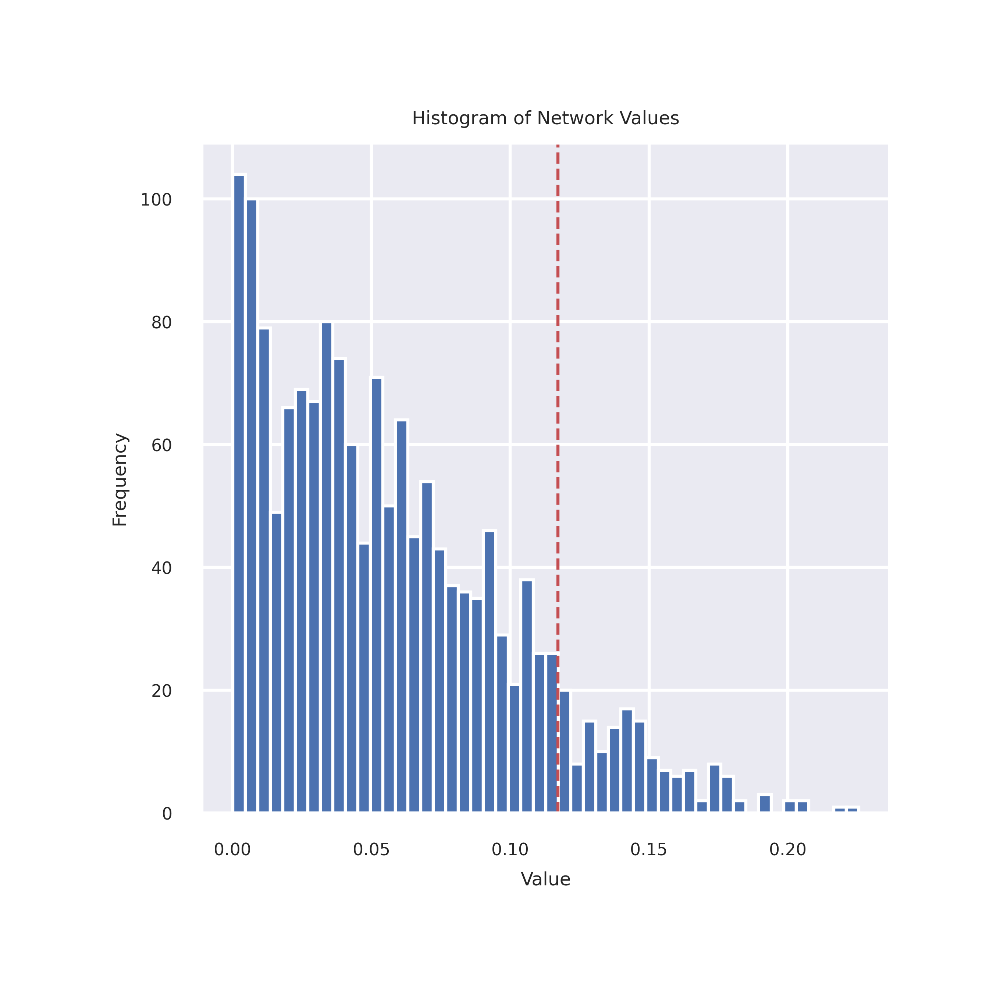

In [82]:
_ = plt.hist(network_values, bins=50)

threshold = np.percentile(network_values, 90)
print(f"90th percentile threshold: {threshold}")

plt.axvline(threshold, color='r', linestyle='dashed', linewidth=1)
plt.title('Histogram of Network Values')
plt.xlabel('Value')
plt.ylabel('Frequency')
plt.show()

In [83]:
threshold = 0.11 ##90th percentile of distribution

In [84]:
c2c.plotting.ccc_networks_plot(factors,
                               included_factors=['Factor 1', 'Factor 2', 'Factor 3','Factor 4', 'Factor 5', 'Factor 6','Factor 7', 'Factor 8'],
                               ccc_threshold=threshold, 
                               nrows=4,
                               panel_size=(20, 20),
                               filename='./cmc_mye/Factor-Networks.pdf',
                              )

(<Figure size 12000x24000 with 8 Axes>,
 array([[<Axes: title={'center': 'Factor 1'}>,
         <Axes: title={'center': 'Factor 2'}>],
        [<Axes: title={'center': 'Factor 3'}>,
         <Axes: title={'center': 'Factor 4'}>],
        [<Axes: title={'center': 'Factor 5'}>,
         <Axes: title={'center': 'Factor 6'}>],
        [<Axes: title={'center': 'Factor 7'}>,
         <Axes: title={'center': 'Factor 8'}>]], dtype=object))

### Gini coefficients of the factor-specific cell-cell communication

In [85]:
c2c.analysis.tensor_downstream.compute_gini_coefficients(
    factors,
    sender_label='Sender Cells',
    receiver_label='Receiver Cells'
).sort_values('Gini')


,Factor,Gini
0,Factor 1,0.280502
1,Factor 2,0.388136
7,Factor 8,0.424461
3,Factor 4,0.424809
4,Factor 5,0.441782
6,Factor 7,0.450539
5,Factor 6,0.465011
2,Factor 3,0.475788


The Gini coefficient is a measure of inequality; in this context, it quantifies how unevenly distributed the communication strength is across different factors.



We observe that the lowest Gini coefficient was obtained by factor 1, which represent more general patterns of communication across genotypes

Factor 3 is more specialized in conditions due to its high score. this is interesting to study genotype specifcic communication patterns

## Pathway Enrichment of LR loadings

Open the loadings obtained from the tensor factorization

In [86]:
factors = c2c.io.load_tensor_factors('./cmc_mye/Loadings.xlsx')

In [87]:
lr_pairs = li.resource.select_resource('mouseconsensus')
lr_pairs.head()

,ligand,receptor
31371,Dll1,Notch1
31372,Dll1,Notch2
31373,Dll1,Notch4
31374,Dll1,Notch3
31375,Nrg2,Erbb2_Erbb3


Generate a list with the LR pair names

In [88]:
lr_list = ['^'.join(row) for idx, row in lr_pairs.iterrows()]

### Gene set enrichment analysis

In [89]:
organism = 'mouse' 
pathwaydb = 'Reactome' 

##### Generate the LR-gene set that will be used for running GSEA

In [90]:
lr_set = c2c.external.generate_lr_geneset(lr_list,
                                          complex_sep='_',
                                          lr_sep='^',
                                          pathwaydb=pathwaydb,
                                          organism=organism,
                                          readable_name=True,
                                          output_folder='./cmc_mye'
                                          )

Extract LR loadings for each factor

In [91]:
lr_loadings = factors['Ligand-Receptor Pairs']

##### Run GSEA

In [92]:
%%time
pvals, scores, gsea_df = c2c.external.run_gsea(loadings=lr_loadings,
                                               lr_set=lr_set,
                                               output_folder='./cmc_mye',
                                              )

./cmc_mye already exists.


100%|██████████| 8/8 [00:03<00:00,  2.47it/s]

CPU times: user 4.33 s, sys: 2.82 s, total: 7.15 s
Wall time: 3.29 s


##### Enriched Pathways

In [93]:
gsea_df

,Factor,Term,NES,P-value,Adj. P-value
0,Factor 1,ECM PROTEOGLYCANS,-1.538879,0.001000,0.068000
1,Factor 1,NEUTROPHIL DEGRANULATION,1.416352,0.031093,0.507925
2,Factor 1,INNATE IMMUNE SYSTEM,1.273801,0.054054,0.518624
3,Factor 1,IMMUNE SYSTEM,1.266256,0.024024,0.507925
4,Factor 1,METABOLISM,1.068745,0.383350,1.000000
...,...,...,...,...,...
131,Factor 8,NERVOUS SYSTEM DEVELOPMENT,0.837943,0.792585,1.000000
132,Factor 8,INTEGRIN CELL SURFACE INTERACTIONS,0.828591,0.881882,1.000000
133,Factor 8,DEVELOPMENTAL BIOLOGY,0.794469,0.862725,1.000000
134,Factor 8,ADAPTIVE IMMUNE SYSTEM,0.787924,0.834677,1.000000


NES (Normalized Enrichment Score): The NES is a metric that reflects the degree of enrichment of a gene set in a particular sample or condition. Higher NES values indicate greater enrichment of the gene set, meaning that the genes in that set are more highly expressed in the specific context being analyzed.

P-value: This indicates the statistical significance of the enrichment score. A low p-value suggests that the observed enrichment is unlikely to have occurred by chance. Typically, a p-value threshold (e.g., < 0.05) is used to determine significance.

Adj. P-value (Adjusted P-value): This value accounts for multiple testing corrections (like the Benjamini-Hochberg method). Adjusted p-values help control the false discovery rate when assessing the significance of multiple gene sets. A lower adjusted p-value indicates more confidence that the observed enrichment is truly significant.

In [94]:
enriched_gsea_df = gsea_df[(gsea_df['P-value'] <= 0.05) & (gsea_df['NES'] >= 1)]
enriched_gsea_df

,Factor,Term,NES,P-value,Adj. P-value
1,Factor 1,NEUTROPHIL DEGRANULATION,1.416352,0.031093,0.507925
3,Factor 1,IMMUNE SYSTEM,1.266256,0.024024,0.507925
34,Factor 3,METABOLISM,1.401232,0.040775,0.507925
35,Factor 3,DEVELOPMENTAL BIOLOGY,1.359643,0.041082,0.507925
51,Factor 4,NERVOUS SYSTEM DEVELOPMENT,1.472911,0.012012,0.354309
52,Factor 4,DEVELOPMENTAL BIOLOGY,1.462395,0.013026,0.354309
68,Factor 5,METABOLISM,1.410984,0.029562,0.507925
106,Factor 7,IMMUNE SYSTEM,1.315861,0.009009,0.354309
119,Factor 8,NEUTROPHIL DEGRANULATION,1.373481,0.035070,0.507925


In [95]:
depleted_gsea_df = gsea_df[(gsea_df['P-value'] <= 0.05) & (gsea_df['NES'] <=  1)]
depleted_gsea_df

,Factor,Term,NES,P-value,Adj. P-value
0,Factor 1,ECM PROTEOGLYCANS,-1.538879,0.001,0.068
102,Factor 7,CELL SURFACE INTERACTIONS AT THE VASCULAR WALL,-1.448765,0.001,0.068


In [96]:
gsea_df.to_csv('./cmc_mye/Enriched_pathways_cmc_mye.csv', index= False)

##### Visualization

ValueError: no types given

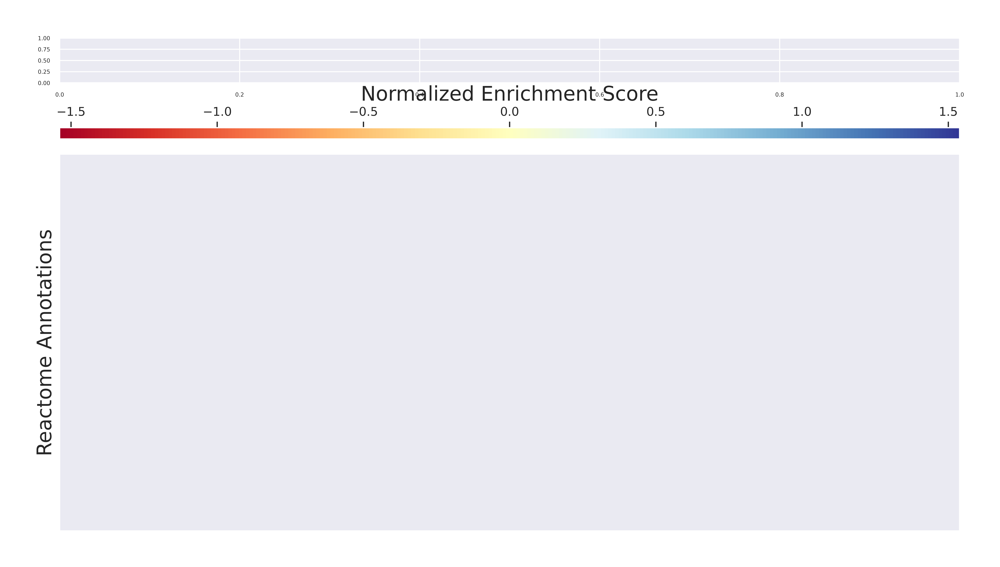

In [97]:
with sns.axes_style("darkgrid"):
    dotplot = c2c.plotting.pval_plot.generate_dot_plot(pval_df=pvals,
                                                       score_df=scores,
                                                       xlabel='',
                                                       significance = 0.05 , #P value and it is defualt
                                                       ylabel='{} Annotations'.format(pathwaydb),
                                                       cbar_title='Normalized Enrichment Score',
                                                       cmap='RdYlBu',
                                                       label_size=20,
                                                       title_size=20,
                                                       tick_size=12,
                                                       filename='./cmc_mye/GSEA_dotplot_cmc_mye.png'
                                                      )


##### Visualization - Circos plot

In [112]:
interaction_data = cmc_mye.uns['liana_res']
sample_to_condition = {           
    'A9_2': 'WT', 
    'A10_2': 'WT', 
    'A11_2': 'Mdx',
    'A12_2': 'Mdx',
    'B1_2': 'MdxSCID',
    'B2_2': 'MdxSCID',
}
interaction_data['condition'] = interaction_data['sample'].map(sample_to_condition)
cmc_mye.uns['liana_res'] = interaction_data


def liana_to_circos_grid_plot(
        liana_res: pd.DataFrame,
        interaction_metric: str = 'magnitude_rank',
        palette: dict = None,
        figsize=(25, 25),  
        fixed_radius=0.8,  
        nrows=2,  
        ncols=2,
        dpi=300,  
        output_filename='./cmc_mye/circos_grid_plot.png'  
):
    if interaction_metric == 'magnitude_rank':
        liana_res['magnitude_rank_inverted'] = liana_res['magnitude_rank'].apply(lambda x: -np.log10(x + np.finfo(float).eps))
        interaction_metric = 'magnitude_rank_inverted'

    conditions = liana_res['condition'].unique()
    fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=figsize, subplot_kw={'polar': True}, dpi=dpi)
    axes = axes.flatten()  

    for idx, condition in enumerate(conditions):
        if idx >= nrows * ncols:
            print("Warning: More conditions than grid spaces; some conditions will not be plotted.")
            break

        condition_data = liana_res[liana_res['condition'] == condition]

        source_target_table = (
            condition_data
            .groupby(['source', 'target'])
            .aggregate(
                {interaction_metric: 'sum'}
            )
            .pivot_table(
                columns='target',
                index='source',
                values=interaction_metric
            )
            .fillna(0)
        )

        if palette:
            all_labels = list(set(source_target_table.index) | set(source_target_table.columns))
            cmap = {label: palette.get(label, '#808080') for label in all_labels}
        else:
            cmap = 'tab20'

        circos = Circos.initialize_from_matrix(
            source_target_table,
            space=2,
            cmap=cmap,
            label_kws=dict(size=12, orientation="vertical"),
            link_kws=dict(direction=1, ec="black", lw=0.5),
        )

        for sector in circos.sectors:
            sector.inner_radius = fixed_radius
            sector.outer_radius = fixed_radius

        circos.plotfig(ax=axes[idx])
        axes[idx].set_title(f'Interactions in {condition}', va='bottom', pad=130, fontsize=18)

    for i in range(len(conditions), nrows * ncols):
        axes[i].axis('off')

    plt.tight_layout()
    plt.savefig(output_filename, dpi=dpi, bbox_inches='tight')
    plt.show()


In [113]:
df = cmc_mye.uns['liana_res']
df['inv_magnitude_rank'] = -df['magnitude_rank']
top_n = 30
top_interactions = df.nsmallest(top_n, 'magnitude_rank')
liana_to_circos_grid_plot(top_interactions, figsize=(25, 25), fixed_radius=0.8, dpi=300)

### Footprint Enrichment

Footprint enrichment analysis build upon classic geneset enrichment analysis, as instead of considering the genes involved in a biological activity, they consider the genes affected by the activity, or in other words the genes that change downstream of said activity. we will use the PROGENy pathway resource to perform footprint enrichment analysis. PROGENy was built in a data-driven manner using perturbation and cancer lineage data , as a consequence it also assigns different importances or weights to each gene in its pathway genesets.

##### Load the PROGENy pathway resource

In [ ]:
net = dc.get_progeny(organism='mouse', top=5000)

In [ ]:
lr_progeny = li.rs.generate_lr_geneset(lr_pairs, net, lr_sep="^")
lr_progeny.head()